<a href="https://colab.research.google.com/github/abdinegara783/BigDataChallage2023/blob/main/Preprocessing%2BFineTunningModel.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<center>
  <h2>
      <b>Optimisasi Pendeteksian Plat Nomor menggunakan Rotasi Adaptive dan <a href="https://github.com/xinntao/Real-ESRGAN">REAL-ESRGAN</a></b>
  </h2>


---


  <p>Berikut ini adalah program untuk mendeteksi <strong>Plat Nomor</strong> dengan menggunakan <strong>Fine Tuning TR-OCR</strong></p>
</center>

<center>
  <img src="https://learnopencv.com/wp-content/uploads/2022/03/Automatic-License-Plate-Recognition-using-Deep-Learning.gif">
</center>

<p align="justify">
    Pengembangan sistem deteksi plat nomor otomatis memberikan manfaat yang luas dalam transportasi, keamanan, dan pengawasan lalu lintas. Teknologi pengenalan nomor kendaraan memungkinkan sistem untuk mengidentifikasi karakter plat nomor secara otomatis yang dapat mengurangi pemeriksaan secara manual. Hal ini bermanfaat dalam penanganan lalu lintas, pengendalian parkir, dan pengawasan keamanan yang lebih efektif. Selain itu, deteksi plat nomor otomatis memainkan peran penting dalam keamanan dan penegakan hukum, dengan memberikan informasi akurat tentang kendaraan terlibat dalam kejahatan atau pelanggaran lalu lintas, memungkinkan penegak hukum untuk mengambil tindakan yang cepat dan tepat.
</p>

<p align="justify">
    Sistem deteksi plat nomor otomatis ini juga dapat digunakan untuk memantau waktu parkir, pembayaran otomatis, dan pengendalian akses parkir. Teknologi ini menghilangkan kebutuhan akan tiket fisik atau kartu akses, mengurangi kemacetan, dan meningkatkan pengalaman pengguna. Pada sistem tol otomatis, deteksi plat nomor membantu mengidentifikasi kendaraan dan memungkinkan pembayaran elektronik yang lebih efisien, sehingga meningkatkan aliran lalu lintas dan mengurangi antrian. Melalui pengumpulan data plat nomor, sistem ini juga memberikan informasi berharga untuk analisis lebih lanjut, seperti pola lalu lintas dan penggunaan parkir, yang mendukung perencanaan transportasi yang lebih baik.
</p>

<center>

  <h3><b>Berikut ini adalah Diagram Alir dari Penelitian Kami</strong></b></h3>
  <br>
  <img src="https://s11.gifyu.com/images/SgHOE.gif" width="750">
</center>

<p align="justify">
    Pertama, kami <b>menginputkan dataset</b> ke dalam Google Colab. Lalu, dilakukan <b>proses preprocessing</b> yang penting untuk meningkatkan kualitas data. Proses preprocessing ini melibatkan <b>dua tahap utama</b>, yaitu <b>ESRGAN <a href="https://github.com/xinntao/Real-ESRGAN">(Enhanced Super-Resolution Generative Adversarial Network)</a></b> untuk meningkatkan resolusi gambar dan <b>Adaptive Rotate</b> untuk penyesuaian sudut rotasi gambar. Kedua tahap ini membantu memastikan bahwa dataset kami siap digunakan dalam pelatihan dan pengujian model.
</p>

<p align="justify">
    Berikutnya, dataset kami <b>dibagi menjadi dua bagian</b>, yakni <b>train set</b> dan <b>test set</b>, melalui proses splitting. Train set akan menjadi landasan kami dalam fine-tuning model. Kami menggunakan train set ini untuk <b>melatih model</b> kami agar dapat menghasilkan prediksi yang lebih baik. Setelah melalui <b>tahap pelatihan</b> dan <b>fine-tuning</b>, kami <b>menghasilkan model</b> yang telah disesuaikan dengan dataset kami. Model ini kemudian digunakan untuk <b>melakukan prediksi</b> menggunakan <b>test set</b>. Dengan mengikuti langkah-langkah ini, kami berhasil mengembangkan model yang dioptimalkan dan mampu menghasilkan prediksi yang lebih baik.
</p>

<center>
  <h3><b>Berikut ini adalah Hasil dari ESRGAN dan Adaptive Rotating</strong></b></h3>
  <br>
  <img src="https://s11.gifyu.com/images/SgHyH.gif" width="750">
</center>

<p align="justify">
    Berikut ini diberikan beberapa sampel gambar yang menggambarkan perbandingan antara citra asli, citra setelah melalui proses ESRGAN, serta citra setelah mengalami proses ESRGAN dan rotasi. Terlihat dengan jelas bahwa citra asli memiliki kualitas yang kurang bagusdan sedikit buram. Setelah melalui proses ESRGAN, citra menjadi lebih tajam dan jelas. Selanjutnya, dengan penerapan rotasi, citra tampak sangat baik dengan orientasi yang benar (tidak miring).
</p>

<center>
  <img src="https://s11.gifyu.com/images/SgHo4.gif">
</center>


<p align="justify">
    <strong>Awalnya</strong>, dataset gambar diberikan sebagai input. Setiap gambar dalam dataset kemudian mengalami proses <strong>kontras stretching</strong>, yang membantu meningkatkan kontras dan kualitas visual gambar. Selanjutnya, gambar-gambar tersebut diubah <strong>ukurannya</strong> agar tidak terlalu besar atau kecil, memastikan konsistensi dalam ukuran gambar.
</p>
<p align="justify">
    Selanjutnya, dilakukan <strong>deteksi tepi</strong> pada gambar menggunakan metode <strong>Canny</strong> untuk mengidentifikasi area dengan perubahan tajam dalam intensitas warna. Proses ini menghasilkan tepi-tepi pada gambar, termasuk <strong>tepi horizontal</strong> dan <strong>vertikal</strong>. Tepi-tepi ini kemudian <strong>dikelompokkan</strong> berdasarkan <strong>kemiringan tepi</strong>, menghasilkan kelompok kemiringan tepi horizontal dan vertikal yang terpisah. Setelah mengelompokkan tepi-tepi, proses selanjutnya adalah <strong>mendapatkan kemiringan tepi horizontal dan vertikal</strong> yang dominan dalam setiap kelompok. Informasi ini digunakan untuk <strong>merotasi gambar</strong> agar sesuai dengan orientasi yang lebih tepat.
</p>
<p align="justify">
    Selanjutnya, gambar yang telah dirotasi diteruskan ke <strong>deteksi bounding box</strong> menggunakan model <strong>YOLO</strong> yang telah dilakukan<strong>fine tuning</strong> khusus untuk <strong>deteksi plat nomor</strong>. Model ini memprediksi <strong>bounding box</strong> di sekitar plat nomor pada gambar. Jika <strong>skor kepercayaan</strong> dari prediksi lebih dari <strong>0.9</strong>, maka dilakukan proses <strong>cropping</strong> untuk memfokuskan pada area plat nomor. Jika skor kepercayaan kurang dari <strong>0.9</strong>, langkah ini dilewati. Setelah itu gambar siap untuk dimasukan dalam <strong>model deep learning</strong> untuk <strong>diprediksi plat nomornya</strong>.
</p>

#**Mempersiapkan Library dan Modul**


###**Menginstall Library yang Dibutuhkan**

In [ ]:
# Mengisntal pustaka "datasets"
!pip install datasets
# Menginstal pustaka "transformers"
!pip install transformers
# Menginstal pustaka "jiwer" atau "Joint-Word Error Rate" untuk mengukur tingkat kesalahan model
!pip install jiwer

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 519.3/519.3 kB 8.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.3/115.3 kB 15.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 13.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 18.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 16.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.4/7.4 MB 19.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 55.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 68.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 13.9 MB/s eta 0:00:00


###**Mengimport Modul yang Dibutuhkan**

In [ ]:
import re                        # Modul untuk ekspresi reguler
import io                        # Modul untuk operasi input/output
import os                        # Modul untuk operasi sistem
import cv2                       # Modul untuk pengolahan citra
import math                      # Modul untuk operasi matematika
import torch                     # Mpdul untuk komputasi tensor
import random                    # Modul untuk pengacakan
import shutil                    # Modul untuk operasi pengarsipan
import zipfile                   # Modul untuk mengekstrak file zip
import requests                  # Modul untuk permintaan HTTP
import statistics                # Modul untuk perhitungan statistik
import numpy as np               # Modul untuk komputasi numerik
import matplotlib.pyplot as plt  # Modul untuk visualisasi data

from google.colab import files   # Modul files dari Google Colab
from transformers import AdamW   # Optimizer AdamW dari Transformers
from google.colab import drive   # Modul untuk menghubungkan dengan Google Drive
from tqdm.notebook import tqdm   # Fungsi untuk bar progres dalam lingkungan notebook
from PIL import Image, ImageOps  # Modul untuk pemrosesan gambar
from datasets import load_metric             # Fungsi untuk memuat metrik dari pustaka datasets
from torch.utils.data import Dataset         # Kelas Dataset dari pustaka PyTorch
from skimage.filters import threshold_local  # Fungsi untuk filter citra lokal
from google.colab.patches import cv2_imshow  # Fungsi untuk menampilkan gambar dalam Colab
from transformers import (                   # Modul untuk pustaka Transformers
    TrOCRProcessor, Trainer, TrainingArguments,
    VisionEncoderDecoderModel, YolosFeatureExtractor, YolosForObjectDetection)

###**Menautkan Drive ke dalam Google Colab**

In [ ]:
# Menautkan Drive kedalam Google Colab
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [ ]:
def calculate_similarity_score(vehicle1, vehicle2):
    highest_score = 0
    highest_score_vehicle = None

    for vehicle in vehicle2:
        score = 0
        total_chars = max(len(vehicle1), len(vehicle))

        for char1, char2 in zip(vehicle1, vehicle):
            if char1 == char2:
                score += 1

        similarity_score = score / total_chars

        if similarity_score > highest_score:
            highest_score = similarity_score
            highest_score_vehicle = vehicle

    return highest_score_vehicle, highest_score


#**Training Set**

##**ERESGAN Processing**

###**Preparations**

In [ ]:
# Clone repository Real-ESRGAN
!git clone https://github.com/xinntao/Real-ESRGAN.git

# Masuk menuju direktori Real-ESRGAN
%cd Real-ESRGAN

# Install pustaka "basicsr", "facexlib", dan "gfpgan" untuk persiapan lingkungan
!pip install basicsr
!pip install facexlib
!pip install gfpgan

# Install dependensi dari berkas requirements.txt
!pip install -r requirements.txt

# Eksekusi skrip setup.py untuk pengembangan
!python setup.py develop

Cloning into 'Real-ESRGAN'...
remote: Enumerating objects: 755, done.
remote: Total 755 (delta 0), reused 0 (delta 0), pack-reused 755
Receiving objects: 100% (755/755), 5.37 MiB | 16.65 MiB/s, done.
Resolving deltas: 100% (410/410), done.
/content/Real-ESRGAN
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 172.5/172.5 kB 1.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 299.2/299.2 kB 13.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 7.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 250.3/250.3 kB 2.8 MB/s eta 0:00:00
  Created wheel for basicsr: filename=basicsr-1.4.2-py3-none-any.whl size=214817 sha256=5e8e67d20a6834b00f2886c0173e0489878b5af3e0bcb70498c7793c92490f73
  Stored in directory: /root/.cache/pip/wheels/38/83/99/2d8437cc652a01af27df5ff037a4075e95b52d67705c5f30ca
Successfully built basicsr


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.6/59.6 kB 742.6 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.0/178.0 kB 10.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for filterpy: filename=filterpy-1.4.5-py3-none-any.whl size=110459 sha256=14b7347eaf89885036080a4fe68620343a7d2d8393a6b8694270cd0bba1384cd
  Stored in directory: /root/.cache/pip/wheels/0f/0c/ea/218f266af4ad626897562199fbbcba521b8497303200186102
Successfully built filterpy
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.2/52.2 kB 842.6 kB/s eta 0:00:00
/usr/local/lib/python3.10/dist-packages/setuptools/__init__.py:84: _DeprecatedInstaller: setuptools.installer and fetch_build_eggs are deprecated.
!!

        ********************************************************************************
        Requirements should be satisfied by a PEP 517 installer.
        If you are using pip, you can try `pip install --use-pep517`.
        *******************************************

###**Mengekstrak File untuk Training Set**

In [ ]:
# Mendefinisikan path dari file zip data train dan path untuk menyimpan hasil ekstraknya
zip_file_path = '/content/drive/MyDrive/BDC_Penyisihan/Rename Data Train for BDC 2023.zip'
extract_path = '/content/DataTrain'

# Membaca file zip dari data train
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    # Mengekstract semua konten dari file zip ke extract path
    zip_ref.extractall(extract_path)

# Notifikasi bahwa file berhasil di ekstrak
print("File berhasil diekstrak")

File successfully extracted.


In [ ]:
# Nama folder untuk upload dan hasil
folder_upload = 'upload'
folder_hasil = 'hasil'

# Menghapus folder jika sudah ada
if os.path.isdir(folder_upload):
    shutil.rmtree(folder_upload)
if os.path.isdir(folder_hasil):
    shutil.rmtree(folder_hasil)

# Membuat folder baru untuk upload dan hasil
os.mkdir(folder_upload)
os.mkdir(folder_hasil)

# Path folder gambar
path_folder_gambar = '/content/DataTrain/Data Train for BDC 2023 - Rename'
gambar_png = [file for file in os.listdir(path_folder_gambar) if file.lower().endswith('.png')]

# Mengunggah gambar-gambar
for nama_file in gambar_png:
    path_file = os.path.join(path_folder_gambar, nama_file)
    path_tujuan = os.path.join(folder_upload, nama_file)
    shutil.copy(path_file, path_tujuan)
    print(f'Telah dipindahkan {nama_file} ke {path_tujuan}')

# Menampilkan daftar file yang diunggah
daftar_file_diunggah = os.listdir(folder_upload)
print(f"File yang diunggah: {daftar_file_diunggah}")

###**Inferensi**

In [ ]:
# Jika terjadi masalah kehabisan memori, coba gunakan opsi `--tile`
# Kami melakukan peningkatan ukuran pada gambar dengan faktor skala X3.5
!python inference_realesrgan.py -n RealESRGAN_x4plus -i upload --outscale 3.5 --face_enhance
# Argumen
# -n, --model_name: Nama model
# -i, --input: folder masukan atau gambar
# --outscale: Skala keluaran, dapat berupa faktor skala sembarang.

/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional_tensor.py:5: UserWarning: The torchvision.transforms.functional_tensor module is deprecated in 0.15 and will be **removed in 0.17**. Please don't rely on it. You probably just need to use APIs in torchvision.transforms.functional or in torchvision.transforms.v2.functional.
  warnings.warn(
Downloading: "https://github.com/xinntao/Real-ESRGAN/releases/download/v0.1.0/RealESRGAN_x4plus.pth" to /content/Real-ESRGAN/weights/RealESRGAN_x4plus.pth

100% 63.9M/63.9M [00:00<00:00, 439MB/s]
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current b

###**Mendownload Hasil dari Training Set**

In [ ]:
# Nama file zip yang akan dibuat
zip_filename = 'Real-ESRGAN_result_Training_Set.zip'

# Jika file zip dengan nama yang sama sudah ada, hapus terlebih dahulu
if os.path.exists(zip_filename):
    os.remove(zip_filename)

# Membuat file zip dengan isi dari folder 'results'
os.system(f"zip -r -j {zip_filename} results/*")

# Mengunduh file zip yang telah dibuat
files.download(zip_filename)

##**Preprocessing of Rotation Image**

### **Function for Preprocessing Image**

In [ ]:
def convert_to_grayscale(image):
    '''
    Converts an image to grayscale if its dimensions are (height, width, 3).
    If the image is already grayscale, it returns the image as it is.

    Parameters:
        image (numpy.ndarray): The input image.

    Returns:
        numpy.ndarray: The grayscale image.
    '''
    if len(image.shape) == 3 and image.shape[2] == 3:
        gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        return gray
    else:
        return image

In [ ]:
def resize_image(image, max_size=400):
    '''
    Resizes an image while maintaining its aspect ratio.

    Parameters:
        image (numpy.ndarray): The input image.
        max_size (int): The maximum size for either width or height of the resized image. Default is 300.

    Returns:
        numpy.ndarray: The resized image.
    '''
    # Calculate the width and height of the image
    height, width = image.shape[:2]

    # Determine the resize scale based on the smallest dimension
    scale = min(max_size / float(width), max_size / float(height))

    # Calculate the new dimensions based on the scale
    new_width = int(scale * width)
    new_height = int(scale * height)

    # Perform the resize
    resized_image = cv2.resize(image, (new_width, new_height))
    return resized_image

In [ ]:
def contrast_stretching(image):
    """
    Perform contrast stretching on the input image.

    Parameters:
        image (numpy.ndarray): Input RGB image.

    Returns:
        numpy.ndarray: Contrast-stretched image.
    """
    # Convert image to float
    image = image.astype(np.float32)

    # Normalize image to the range [0, 1]
    image_normalized = image / 255.0

    # Calculate minimum and maximum pixel values in each channel
    min_vals = np.min(image_normalized, axis=(0, 1))
    max_vals = np.max(image_normalized, axis=(0, 1))

    # Calculate the range of each channel
    ranges = max_vals - min_vals

    # Perform contrast stretching on each channel
    stretched_image = (image_normalized - min_vals) / ranges

    # Clip values outside the range [0, 1]
    stretched_image = np.clip(stretched_image, 0, 1)

    # Convert image back to the original data type
    stretched_image = (stretched_image * 255).astype(np.uint8)
    return stretched_image

In [ ]:
def detect_lines(image, threshold1, threshold2, min_line_length, max_line_gap):
    """
    Detects lines in an image using probabilistic Hough line transform.

    Args:
        image (numpy.ndarray): Grayscale image.
        threshold1 (int): First threshold for the Hough line transform.
        threshold2 (int): Second threshold for the Hough line transform.
        min_line_length (int): Minimum length of a line to be detected.
        max_line_gap (int): Maximum allowed gap between line segments to be connected into a single line.

    Returns:
        numpy.ndarray: Array representing the detected lines.
    """
    # Detects lines with Hough line transform
    lines = cv2.HoughLinesP(image, 1, np.pi/180, threshold=threshold1, minLineLength=min_line_length, maxLineGap=max_line_gap)
    return lines

In [ ]:
def detect_edges(image):
    """
    Detects edges in an image using the Canny edge detection method.

    Args:
        image (numpy.ndarray): Grayscale image.

    Returns:
        numpy.ndarray: Array representing the detected edges.
    """
    # Detects edges using Canny
    edges = cv2.Canny(image, 30, 150)
    return edges

In [ ]:
def rotated_90(image):
    """
    Rotates the input image by 90 degrees clockwise.

    Args:
        image: PIL Image or NumPy array representing the image.

    Returns:
        NumPy array: Rotated and resized image as a NumPy array.
    """
    # Convert the image to a NumPy array
    image_array = np.array(image)

    # Rotate the image by 90 degrees clockwise
    rotated_image = np.rot90(image_array)

    # Get the new width and height from the rotated image shape
    new_height, new_width, _ = rotated_image.shape

    # Create a PIL Image from the rotated NumPy array
    rotated_pil_image = Image.fromarray(rotated_image)

    # Resize the image
    resized_image = rotated_pil_image.resize((new_width, new_height))

    # Convert the image back to a NumPy array
    resized_image = np.array(resized_image)
    return resized_image

In [ ]:
def transform_image(image, angle):
    """
    Performs a perspective transformation on an image based on a specified angle.
    The y position of each pixel remains unchanged, while only the x position changes.

    Args:
        image (numpy.ndarray): Input image.
        angle (float): Angle in degrees for the perspective transformation.

    Returns:
        numpy.ndarray: Transformed image.
    """
    # Convert angle to radians
    angle_radians = np.deg2rad(angle)

    # Calculate the shift amount based on the angle
    height = image.shape[0]
    width = image.shape[1]
    shift = int(width * np.tan(angle_radians))

    # Define the input and output quadrilateral coordinates
    src_pts = np.float32([[0, 0], [width, 0], [width, height], [0, height]])
    dst_pts = np.float32([[0, shift], [width, 0], [width, height], [0, height + shift]])

    # Compute the perspective transform matrix
    matrix = cv2.getPerspectiveTransform(src_pts, dst_pts)

    # Apply the perspective transform to the image
    warped_image = cv2.warpPerspective(image, matrix, (width, image.shape[0]))
    return warped_image

In [ ]:
def add_black_border(image, border_size):
    """
    Adds a black border to an input image.

    Args:
        image (numpy.ndarray): Input image.
        border_size (int): Size of the border to be added.

    Returns:
        numpy.ndarray: Image with the black border added.
    """
    # Get the dimensions of the input image
    height, width = image.shape[:2]

    # Calculate the new dimensions with the added border
    new_height = height + 2 * border_size
    new_width = width + 2 * border_size

    # Create a black image with the new dimensions
    bordered_image = np.zeros((new_height, new_width, 3), dtype=np.uint8)

    # Calculate the coordinates for placing the input image in the center of the bordered image
    x = border_size
    y = border_size

    # Copy the input image to the center of the bordered image
    bordered_image[y:y+height, x:x+width] = image
    return bordered_image

In [ ]:
def crop_black(image):
    """
    Crops an image to remove any black borders or areas.

    Args:
        image (np.ndarray): Input image as a NumPy array.

    Returns:
        PIL.Image.Image: Cropped image.
    """
    # Convert the NumPy array to a PIL Image
    image = Image.fromarray(image)

    # Find the top, bottom, left, and right boundaries
    img_array = np.array(image)
    non_black_rows = np.where(np.any(img_array != 0, axis=1))[0]
    non_black_cols = np.where(np.any(img_array != 0, axis=0))[0]

    if len(non_black_rows) == 0 or len(non_black_cols) == 0:
        # Handle case when no non-black rows or columns found
        return image

    top = non_black_rows[0]
    bottom = non_black_rows[-1] + 1
    left = non_black_cols[0]
    right = non_black_cols[-1] + 1

    # Crop the image using the boundaries found
    cropped_img = image.crop((left, top, right, bottom))

    # Return the cropped image
    return cropped_img

In [ ]:
def average_middle_value(data, bins=20):
    """
    Function to create a histogram and calculate the average middle value of bins with the maximum frequency.

    Parameters:
    - data: A list or array of data points.
    - bins: Number of bins for the histogram. Default is 20.

    Returns:
    - average_middle_value: The average middle value of bins with the maximum frequency.
    """
    # Create a histogram without visualization
    frequencies, bins = np.histogram(data, bins=bins)

    # Find the middle values of the bins with the maximum frequency
    max_frequency = np.max(frequencies)
    max_frequency_bins = bins[np.where(frequencies == max_frequency)]
    bin_width = bins[1] - bins[0]
    middle_values = max_frequency_bins + bin_width / 2

    # Calculate the average middle value if there are multiple bins with the maximum frequency
    average_middle_value = np.mean(middle_values)
    return average_middle_value

###**Function for Visualization**

In [ ]:
def create_histogram(data, bins=20):
    """
    Creates a histogram plot for the given data and displays the histogram plot.

    Args:
        data (array-like): Input data.
        bins (int): Number of bins for the histogram.

    Returns:
        None
    """
    # Create a figure with the specified size
    plt.figure(figsize=(5, 4))

    # Create a histogram with appealing color and edge properties
    plt.hist(data, bins=bins, color='orange', edgecolor='black', alpha=1, linewidth=1.5)

    # Set title and axis labels for the histogram
    plt.title('Histogram')
    plt.xlabel('Data')
    plt.ylabel('Frequency')

    # Display the grid
    plt.grid(True)

    # Display the histogram plot
    plt.show()

###**Preparing a Training Data After ERSGAN Process**

In [ ]:
# Mendefinisikan path dari hasil proses ERSGAN dan path untuk menyimpan hasil ekstrak dari file zipnya
zip_file_path = '/content/drive/MyDrive/ERSGAN_DATA/Real-ESRGAN_result_Train.zip'
extract_path = '/content/DataTrain/ERESGAN_Train'

# Membuka file zip
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    # Mengekstrak semua isi dari file zip ke dalam path ekstraksi yang telah ditentukan
    zip_ref.extractall(extract_path)

# Notifikasi untuk memastikan file berhasil diekstrak
print("File berhasil diekstrak.")

File successfully extracted.


### **Looping for All Training Image**

-1.6154982900083894 



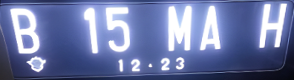

0
-162.20128225803478 



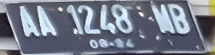

1
-4.34393331978859 



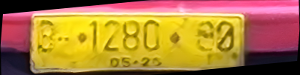

2
-3.65004676917259 



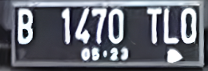

3
-167.2671898687908 



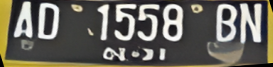

4
-10.042023635529503 



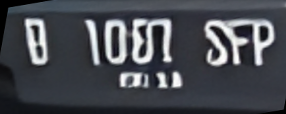

5
-0.1895249092018929 



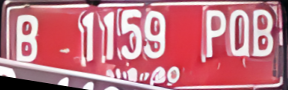

6
-163.00917670801385 



7
-0.1100461318573025 



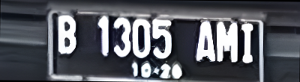

8
-0.2876410294096843 



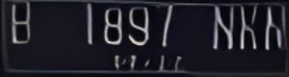

9
-4.631686596283885 



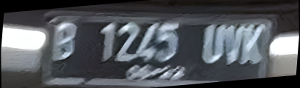

10
-178.09382841530532 



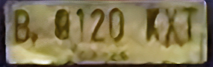

11
-177.15036492778972 



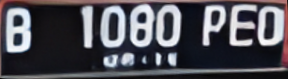

12
-0.10231378323584295 



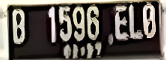

13
-0.6650104343126628 



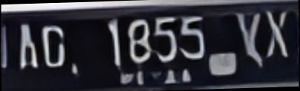

14
-179.48713587618326 



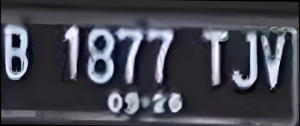

15
-10.282754805558326 



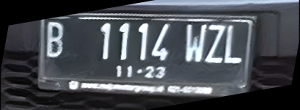

16
-2.812618321910932 



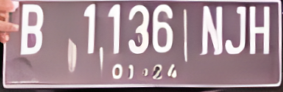

17
-179.93605384405848 



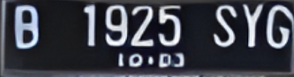

18
-175.24059201362488 



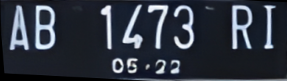

19
-1.2648617587094009 



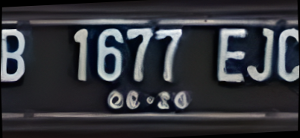

20
-0.06138831170217429 



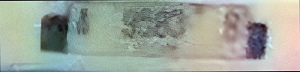

21
-179.95428529200404 



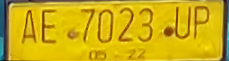

22
-177.3103350858122 



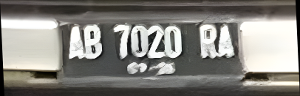

23
-1.5378049269142906 



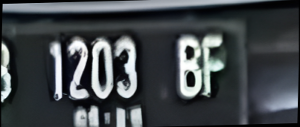

24
-0.23873103309890098 



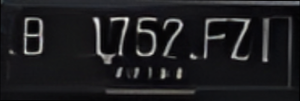

25
-1.9453225703016273 



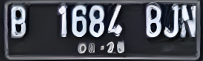

26
-2.5083718912135424 



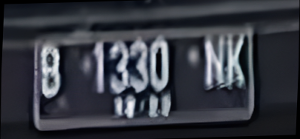

27
-4.858908549659574 



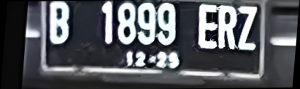

28
-0.030870567871119192 



29
-179.96668850403643 



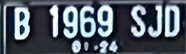

30
-5.496776688046239 



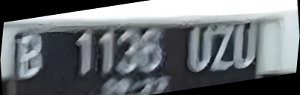

31
-143.59728978117028 



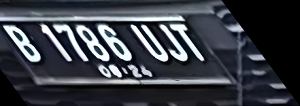

32
-12.954725153874946 



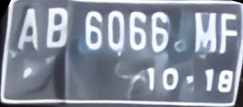

33
-179.29197740250714 



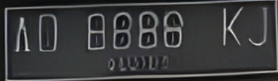

34
-175.71084667118097 



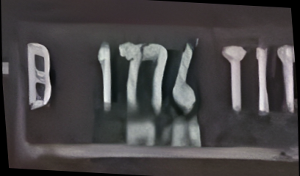

35
-172.98596508731617 



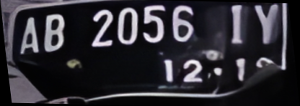

36
-3.0817693425487676 



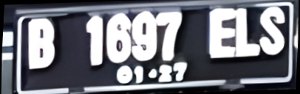

37
-179.92804925153013 



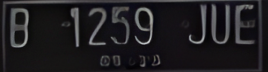

38
-164.38257017992373 



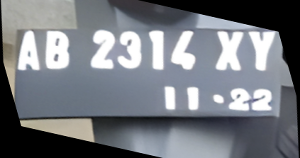

39
-176.99098945544364 



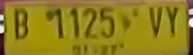

40
-6.721709119960224 



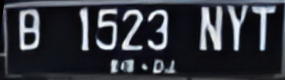

41
-175.1974454230753 



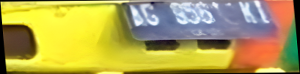

42
-5.053506427951845 



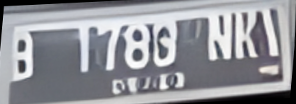

43
-177.5619676668817 



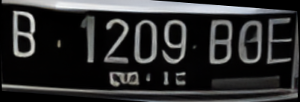

44
-3.525627213747967 



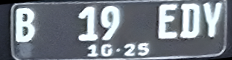

45
-179.66864832076197 



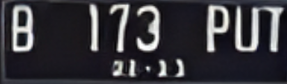

46
-176.86675834370118 



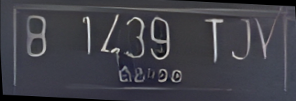

47
-178.56790381583534 



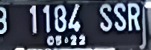

48


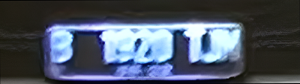

49
-0.1273237448873772 



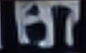

50
-179.50873624358854 



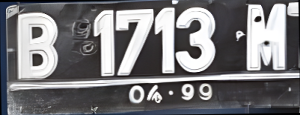

51
-179.29388719240768 



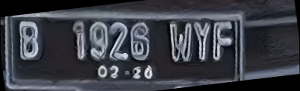

52
-20.581257882208263 



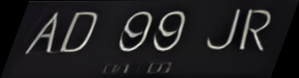

53
-179.3248284647201 



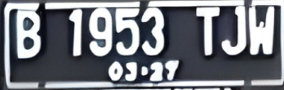

54
-179.77297134287625 



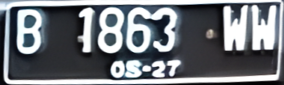

55
-0.027813483015776796 



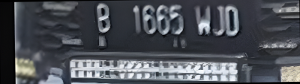

56
-0.42149293859274906 



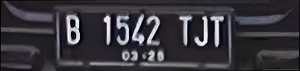

57
-0.2921623907062667 



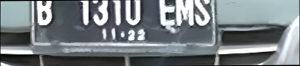

58
-178.56790381583534 



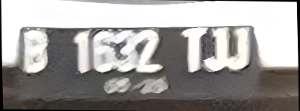

59
-0.813669817820454 



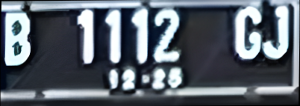

60
-174.82709688020162 



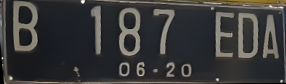

61
-4.970881583750241 



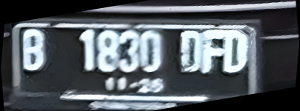

62
-178.0908475670036 



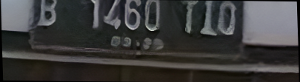

63
-10.570227754464455 



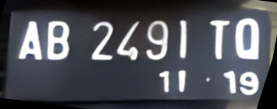

64
-10.36516686407569 



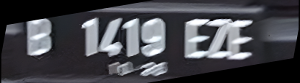

65
-1.6402945052135607 



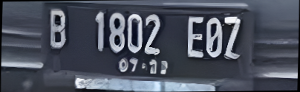

66
-5.318582120058096 



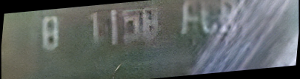

67
-179.07453328605587 



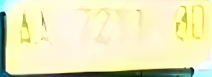

68
-8.985608793265897 



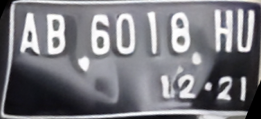

69
-4.781425948196812 



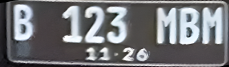

70
-177.36089065226605 



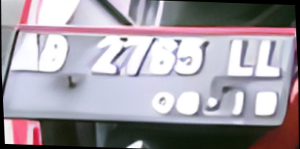

71
-18.884684960483995 



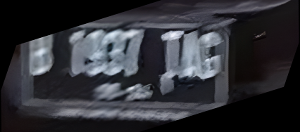

72
-0.026525821953498507 



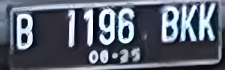

73
-160.9533757023642 



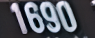

74
-12.53691370296788 



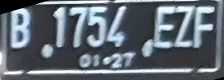

75
-1.334211770672951 



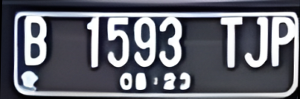

76
-6.9185304633035685 



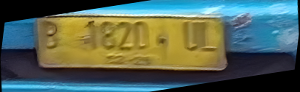

77
-146.04340863377806 



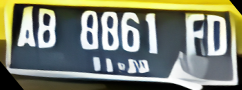

78
-0.4293862364641825 



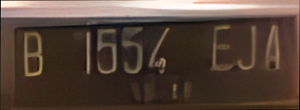

79
-0.27798273290204634 



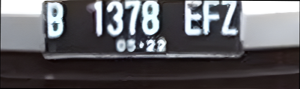

80
-4.979105843998312 



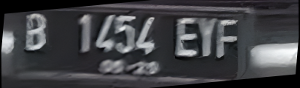

81
-1.1493230755115889 



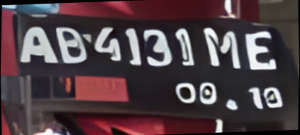

82
-178.26516171372234 



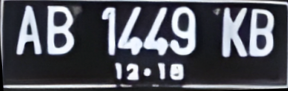

83
-179.9825636708021 



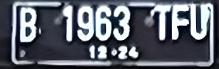

84
-1.01965901582237 



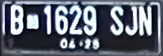

85
-2.3388329230937472 



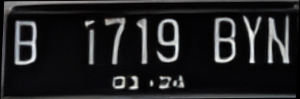

86
-179.98970980982455 



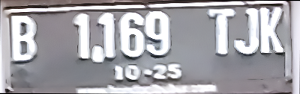

87
-0.3686258481134814 



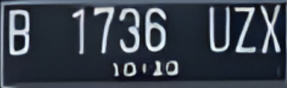

88
-5.128191041852844 



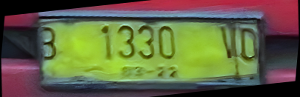

89
-0.7183808559966707 



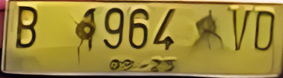

90
-179.6927477435816 



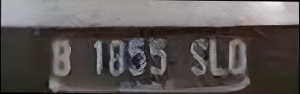

91
-178.8426669318705 



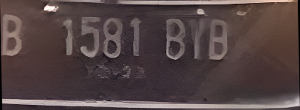

92
-1.4688007143858215 



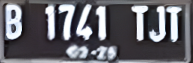

93
-0.7326317350914735 



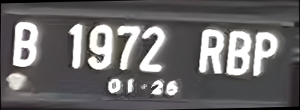

94
-14.164441761033643 



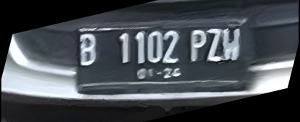

95
-179.77765229862462 



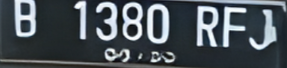

96
-4.563897982679521 



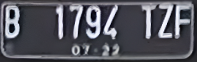

97
-174.31370581057413 



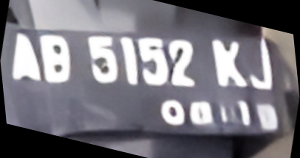

98
-178.4979275917106 



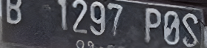

99
-2.980060709002416 



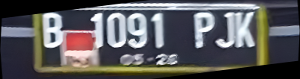

100
-179.8557428073633 



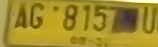

101
-168.91578182217205 



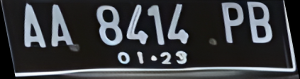

102
-3.8807101577461935 



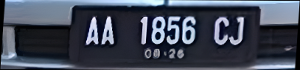

103
-8.795064379855617 



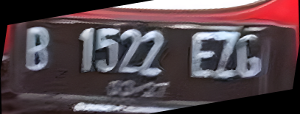

104
-3.5277503349055337 



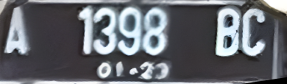

105
-14.67303356786735 



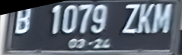

106
-178.56790381583534 



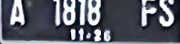

107
-176.405695221967 



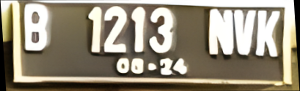

108
-5.137250816010052 



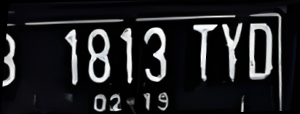

109
-9.250885888125893 



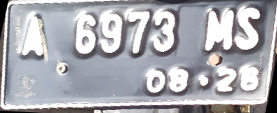

110
-1.0353531865449384 



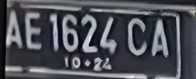

111
-0.0008251120320892369 



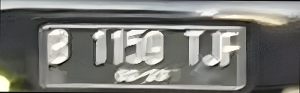

112
-179.9303057619162 



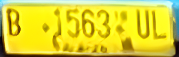

113
-176.74755517430262 



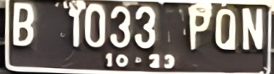

114
-1.71835800165546 



115
-179.73976449453772 



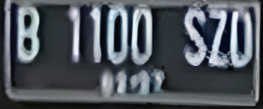

116
-7.61752628693111 



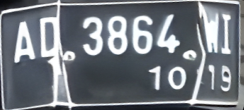

117
-179.22758012868152 



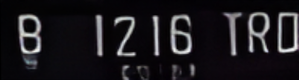

118
-15.708980293722504 



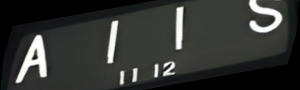

119
-179.11335038613325 



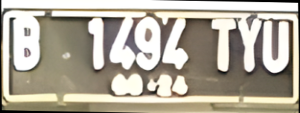

120
-8.103287267577812 



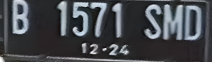

121


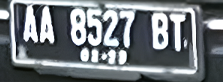

122
-174.76252393318748 



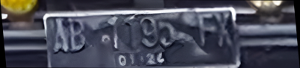

123
-1.3882739323345419 



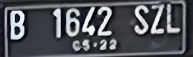

124
-10.47574646980462 



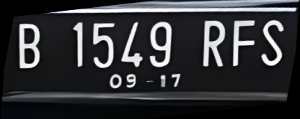

125
-179.70006079953453 



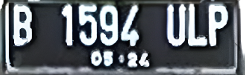

126
-178.32211858860063 



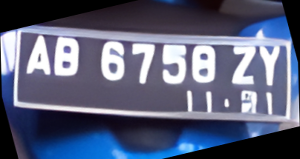

127
-0.05729576041449036 



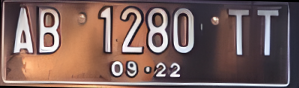

128


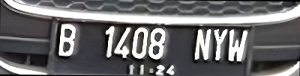

129


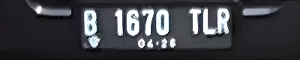

130
-3.131428650144386 



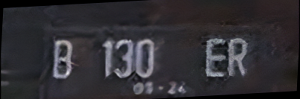

131
-4.002050736728194 



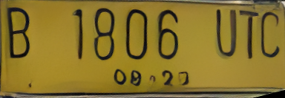

132
-179.9000935949606 



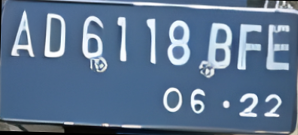

133
-179.975709262923 



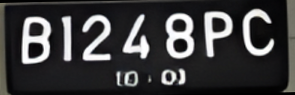

134
-179.09887267613615 



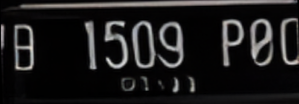

135
-176.72293270755674 



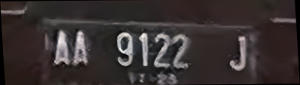

136
-7.125016348901781 



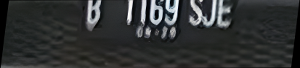

137
-1.750159835324169 



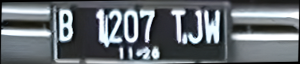

138


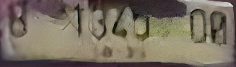

139
-7.142943922314018 



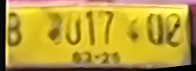

140
-0.6689185919184268 



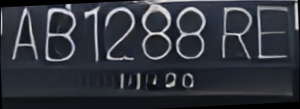

141
-7.44502359706334 



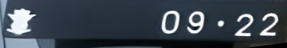

142
-179.91139834972864 



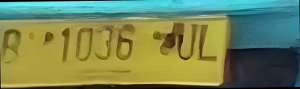

143
-0.5290630675082042 



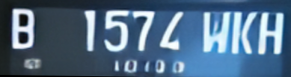

144
-0.12564843786168467 



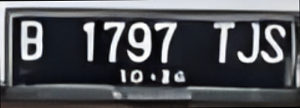

145
-0.01667010779311795 



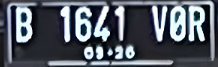

146
-17.35828910325911 



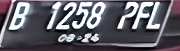

147
-2.862405226111747 



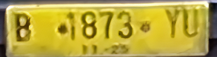

148
-2.8909809597655 



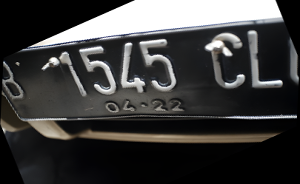

149
-14.92603184364441 



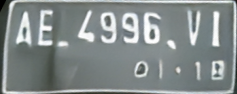

150
-1.8215796643954576 



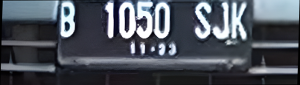

151
-179.2838400545296 



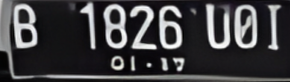

152
-177.64655473421516 



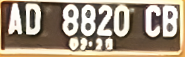

153
-0.04774647187514347 



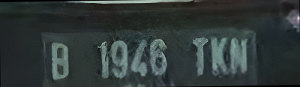

154
-0.05006486896303386 



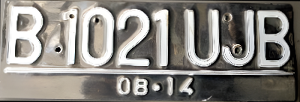

155
-179.93285653911894 



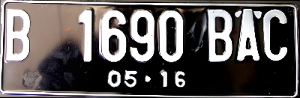

156
-178.9358503675594 



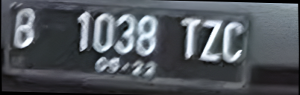

157
-2.0026644410575614 



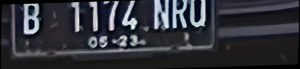

158
-178.56790381583534 



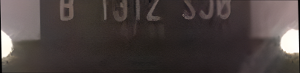

159
-0.31063672477849025 



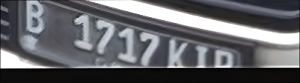

160
-0.3469106535094113 



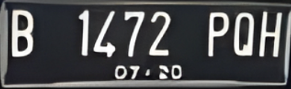

161
-180.0 



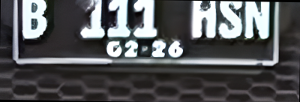

162
-0.17606460161486837 



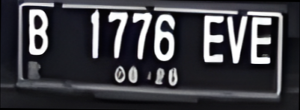

163
-1.1780939289379688 



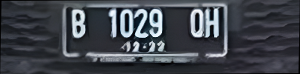

164
-28.803711590889883 



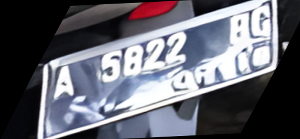

165
-6.03768252142288 



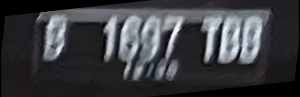

166
-2.499929897191592 



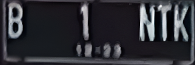

167
-179.19947083162612 



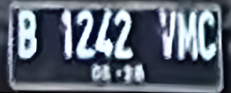

168
-6.242986664520629 



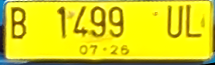

169
-1.4136805162346207 



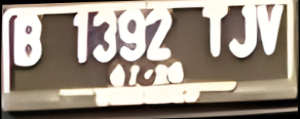

170
-0.059683082072709226 



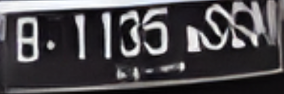

171
-4.977654394703009 



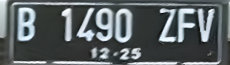

172
-1.7083150963731129 



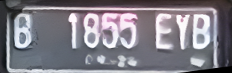

173
-12.8970511461726 



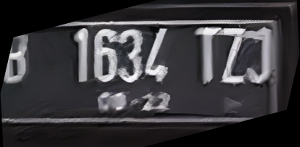

174
-179.91819418027063 



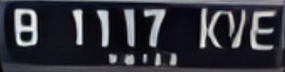

175
-3.864641223810324 



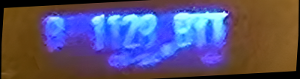

176
-179.78737438213605 



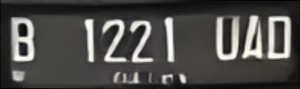

177
-167.07687209137407 



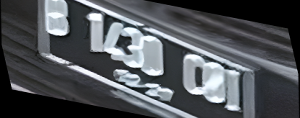

178
-14.254304373254271 



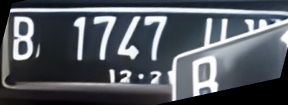

179
-1.1136985204712175 



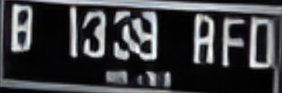

180
-173.58769644205847 



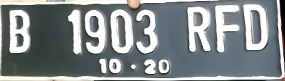

181
-177.79740183823418 



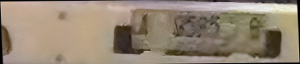

182
-3.9399619433725945 



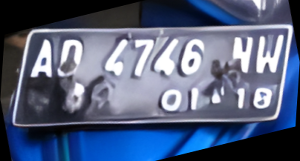

183
-179.932928538475 



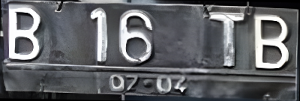

184
-0.12395702189662927 



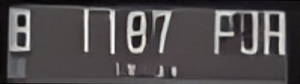

185
-0.8883956274340505 



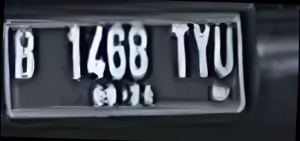

186
-0.20046618852889253 



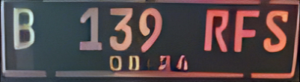

187
-0.09183191333606544 



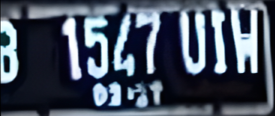

188
-36.48879798932412 



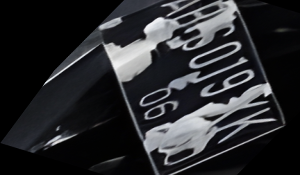

189
-178.81787390106246 



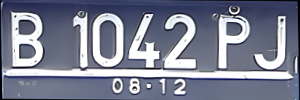

190
-177.37577997221794 



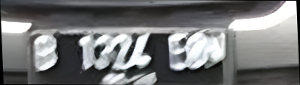

191
-11.322013564279544 



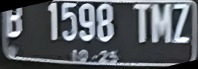

192
-8.118465543095397 



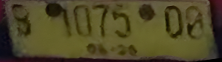

193
-0.04107403902160911 



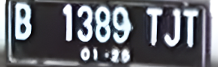

194
-2.0239622717289194 



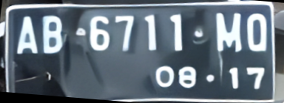

195
-9.479568942879567 



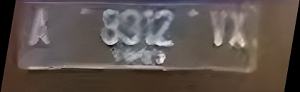

196
-14.108431043090789 



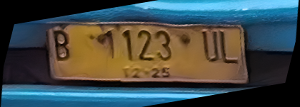

197
-179.76376314330764 



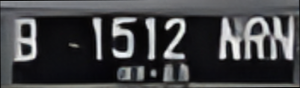

198
-170.6098295980775 



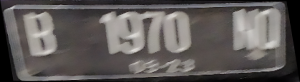

199
-6.6775258529447825 



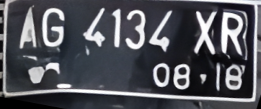

200
-0.5707352333560891 



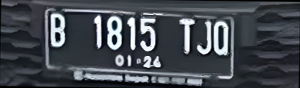

201
-166.52507251944385 



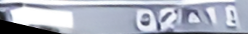

202
-6.862429131013357 



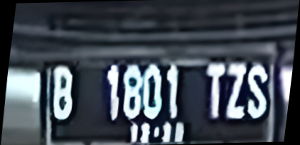

203
-3.697131889043604 



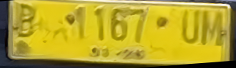

204
-6.087130444965624 



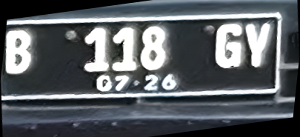

205


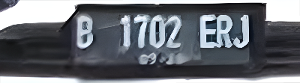

206
-4.0332336632498595 



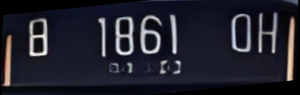

207
-13.564814378311254 



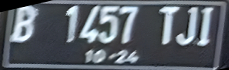

208
-0.31799937200001693 



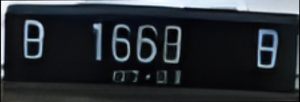

209
-9.35235304207292 



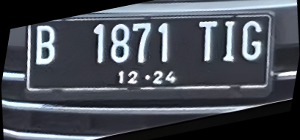

210
-176.01561746916065 



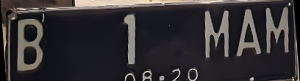

211
-178.01136214352596 



212
-13.156450559696353 



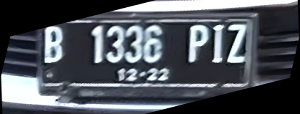

213
-179.5004826998789 



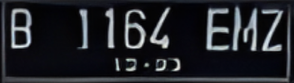

214
-176.4266289180022 



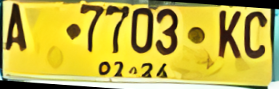

215
-0.2766290359944179 



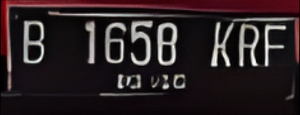

216
-2.273621912067995 



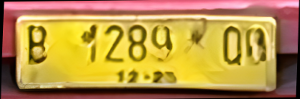

217
-179.63394861131758 



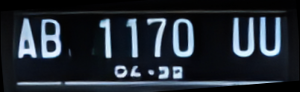

218
-3.0061350907015196 



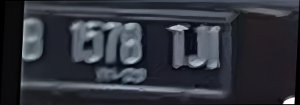

219
-0.0963545834901538 



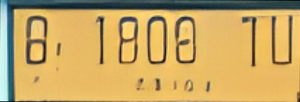

220
-175.87304779090653 



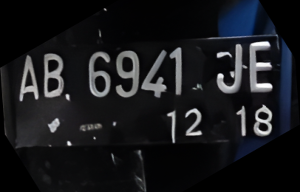

221
-10.639633205755985 



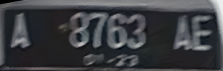

222
-4.732413876409822 



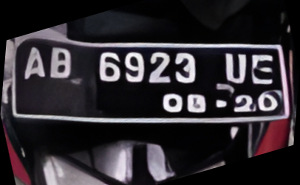

223
-178.11178438393546 



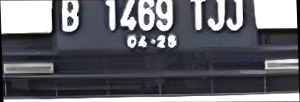

224
-2.227046967413571 



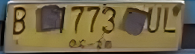

225
-13.776225169118518 



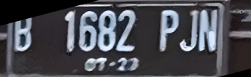

226
-175.7408138117433 



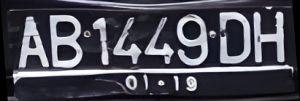

227
-179.8595694490627 



228
-0.14233827892704198 



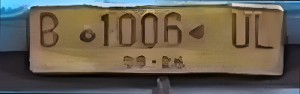

229
-0.04571470799594124 



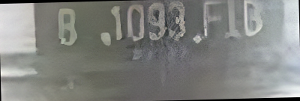

230
-1.1245400273924417 



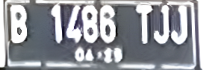

231
-3.6494230367522817 



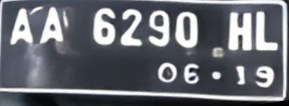

232
-6.543523233822697 



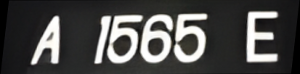

233
-179.95225352812486 



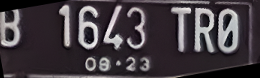

234
-179.91303325859775 



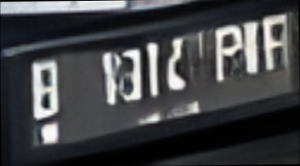

235
-0.02137902121417312 



236
-167.74797491675264 



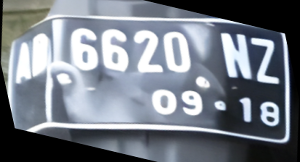

237
-3.272977349578241 



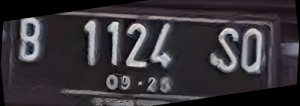

238
-141.7537041089439 



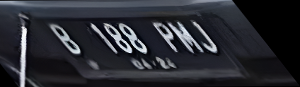

239
-0.5181185941740978 



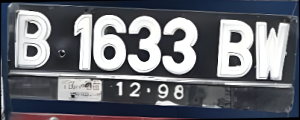

240
-8.972626614896384 



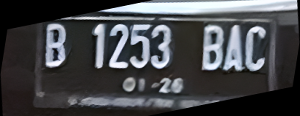

241
-179.99422421579447 



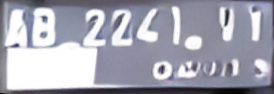

242
-176.01310512019842 



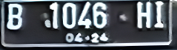

243
-0.2815738929169811 



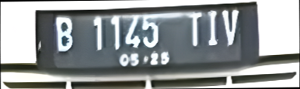

244
-0.9445538905044657 



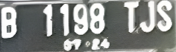

245
-8.72993246433009 



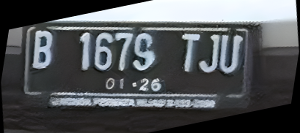

246
-179.00666464772053 



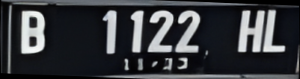

247
-1.0681536374376037 



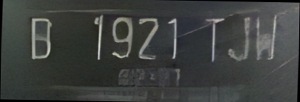

248
-178.64543231467576 



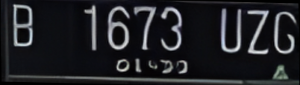

249
-5.851655772745801 



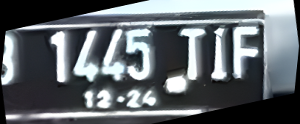

250
-177.714647720461 



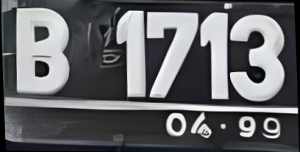

251
-179.21874233839137 



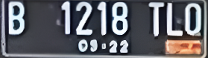

252
-137.43863055476234 



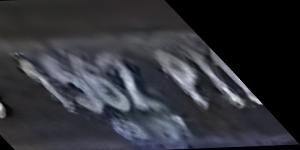

253
-178.985540439173 



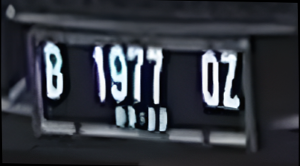

254
-171.9308289729414 



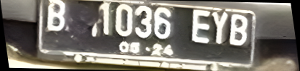

255
-0.11912537799156553 



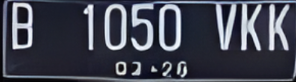

256
-179.0885531253135 



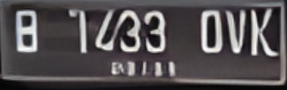

257
-3.071593760509373 



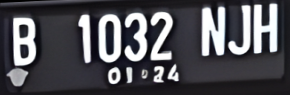

258
-179.3912426724915 



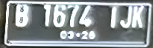

259
-4.252457881097996 



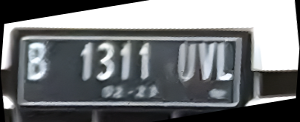

260
-155.40679461198232 



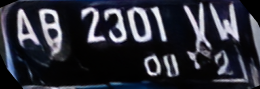

261
-179.84542543028567 



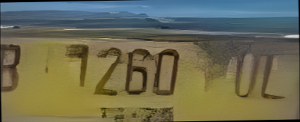

262
-5.307001241200027 



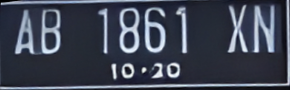

263
-5.299546661129213 



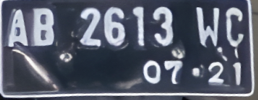

264
-9.152842712033149 



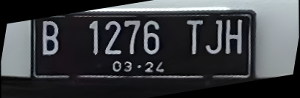

265
-0.6814621510294501 



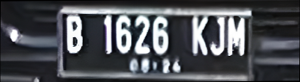

266
-179.97735633512963 



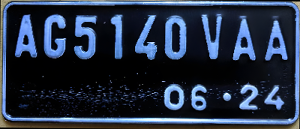

267
-0.13981239020590408 



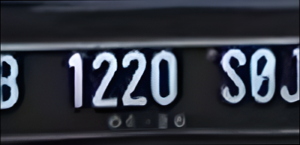

268
-174.49207945019532 



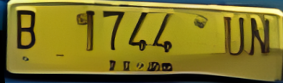

269
-179.96327194124027 



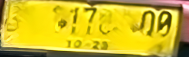

270
-0.7434496191777953 



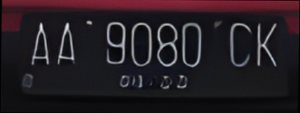

271
-8.923901578133624 



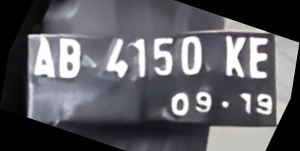

272
-165.26728485221184 



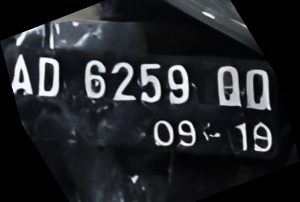

273
-9.401474518384504 



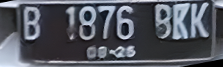

274
-0.190985224359693 



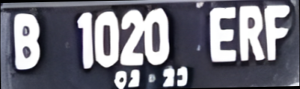

275
-13.901350769509108 



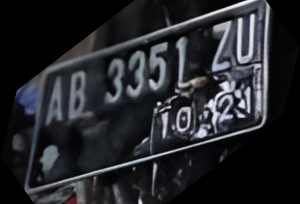

276
-6.461097080075348 



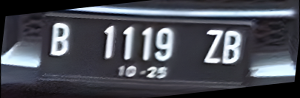

277
-13.154919530542458 



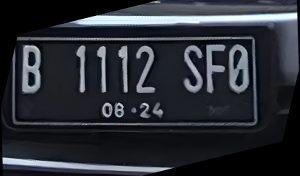

278
-162.97033109762896 



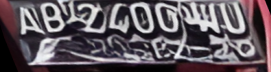

279
-178.34769532234867 



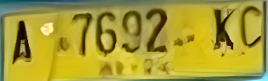

280
-7.609820400289109 



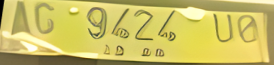

281
-179.86537670565042 



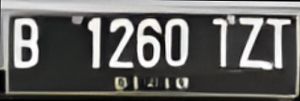

282
-2.564711792640992 



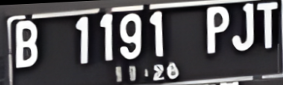

283
-7.278821550546681 



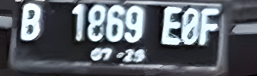

284
-1.1508764781734016 



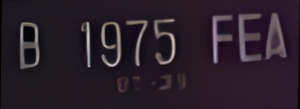

285
-163.99487954164738 



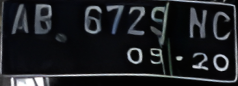

286
-0.39788096183458777 



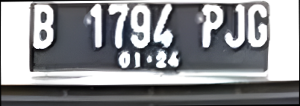

287
-6.15587621554333 



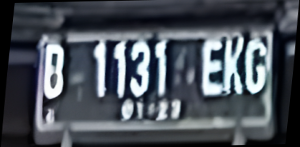

288
-179.99565062403317 



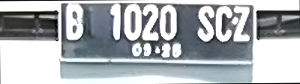

289
-0.39973151104871363 



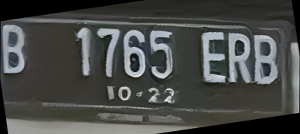

290
-179.59501425556255 



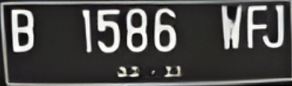

291
-176.1180231122738 



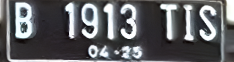

292
-7.6496534706185315 



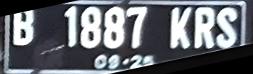

293
-179.9654249648355 



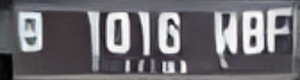

294
-0.5849451762907307 



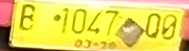

295
-14.815681592263516 



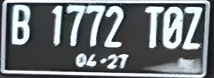

296
-176.44367541648347 



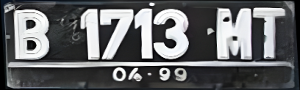

297
-179.96990768159412 



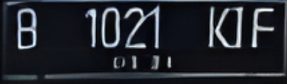

298
-0.7509211026128924 



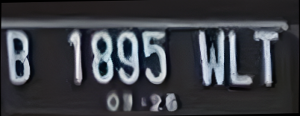

299
-14.174154091432598 



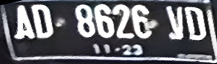

300
-26.076698622467788 



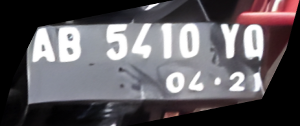

301
-179.94310252166923 



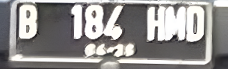

302
-18.70796953155474 



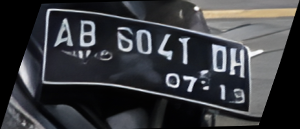

303
-2.749669561138802 



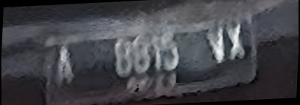

304
-179.69241687760172 



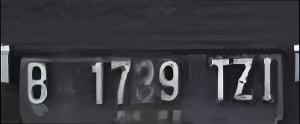

305
-14.331397563971478 



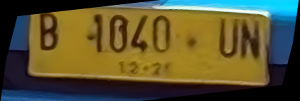

306
-0.028364244966596175 



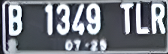

307
-1.0262111821573114 



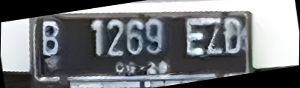

308
-179.44731543133162 



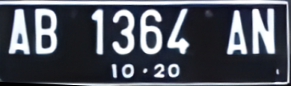

309
-1.8840502310917913 



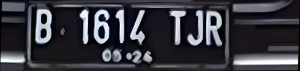

310
-6.047944458934182 



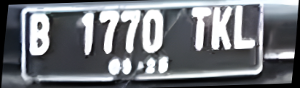

311
-6.813135731482774 



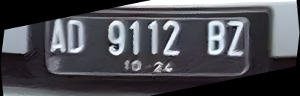

312
-1.5279620038077724 



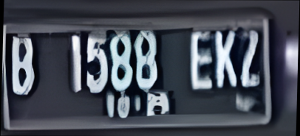

313
-173.6238929485279 



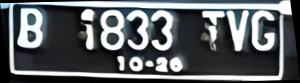

314
-179.1043611205371 



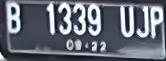

315
-169.53992150720003 



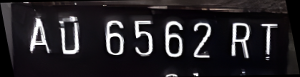

316
-1.4831177590848625 



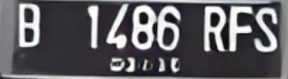

317
-170.29240013165534 



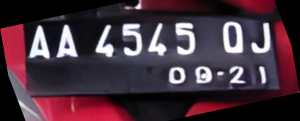

318
-0.11936603462520168 



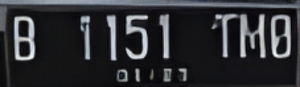

319
-178.571266341502 



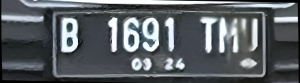

320
-178.56790381583534 



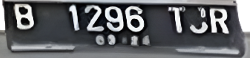

321
-2.038884404570453 



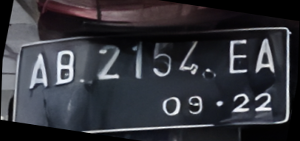

322
-178.53119928561415 



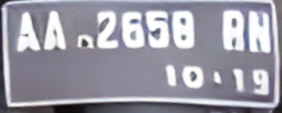

323
-20.26132956231578 



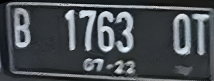

324
-0.3138426452425591 



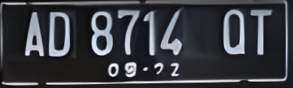

325
-9.079322542798664 



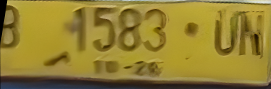

326
-3.424520128604456 



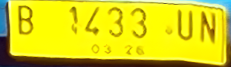

327
-0.048831618443571756 



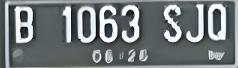

328
-4.595608761519671 



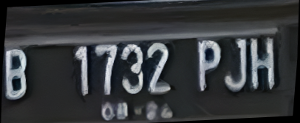

329
-1.2523705843941428 



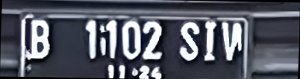

330
-20.430641233154063 



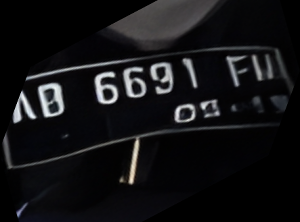

331
-9.086431311219329 



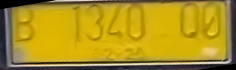

332
-179.84430533020225 



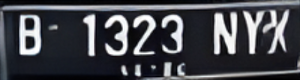

333
-2.834125753235398 



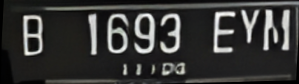

334
-0.18683340141480187 



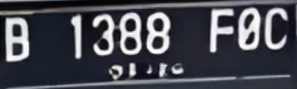

335
-3.4665659081798452 



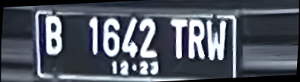

336
-177.75810951017235 



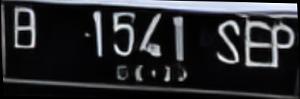

337
-179.6927477435816 



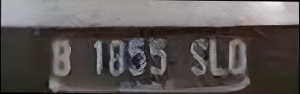

338
-176.38611924799636 



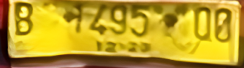

339
-21.491971729366355 



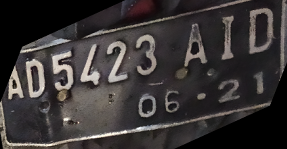

340
-2.489552921999149 



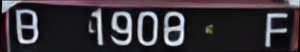

341
-0.4692221869197084 



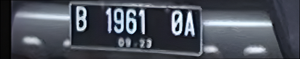

342
-7.717736803651363 



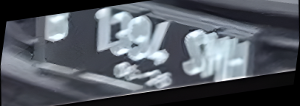

343
-23.096432129740293 



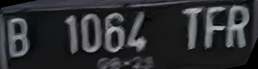

344
-7.618295418234894 



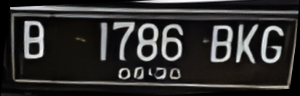

345
-168.34246605460086 



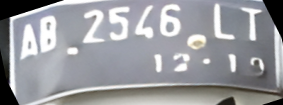

346
-1.12729590279325 



347
-0.30693873970919583 



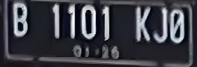

348
-4.082244055395805 



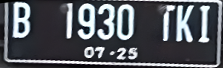

349
-179.72871519246456 



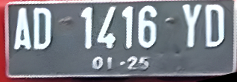

350
-179.99496181593784 



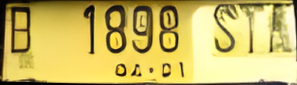

351
-1.1066091545336718 



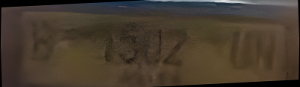

352
-178.56790381583534 



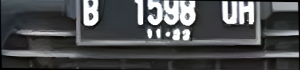

353
-166.2784018852651 



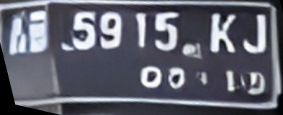

354
-179.5188452039568 



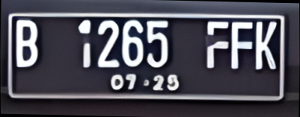

355
-0.5729386976834832 



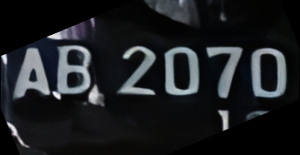

356
-179.00431797732432 



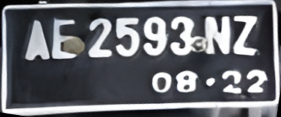

357
-179.2838400545296 



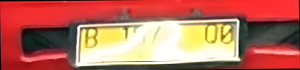

358
-178.56790381583534 



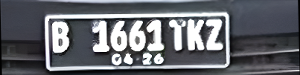

359
-179.7091830105303 



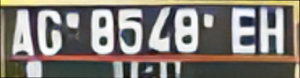

360
-179.05233158018225 



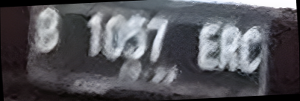

361
-176.4155587594276 



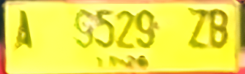

362
-176.66152945623566 



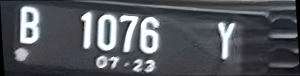

363
-9.571450389802578 



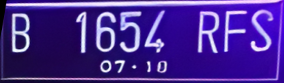

364
-4.030088663443053 



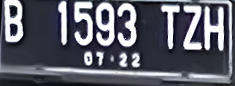

365
-0.08952458263394192 



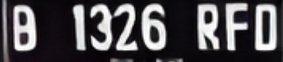

366
-149.30362896153957 



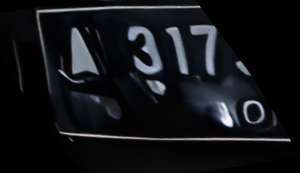

367
-1.859276656010337 



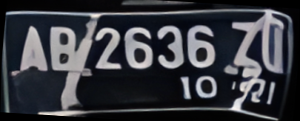

368
-179.36396587658913 



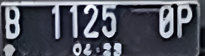

369
-178.56790381583534 



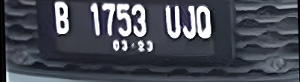

370
-176.63403535004568 



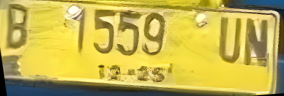

371
-179.97343428959812 



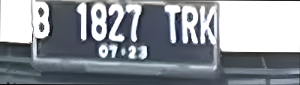

372
-3.87343435552458 



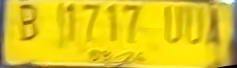

373
-3.765827441184612 



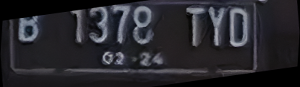

374
-179.24639547114887 



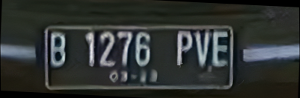

375
-2.094247266057664 



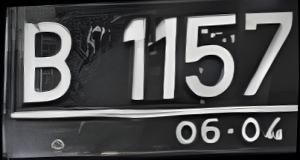

376
-1.8984347280552356 



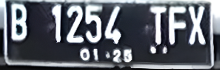

377
-175.63814061944709 



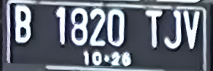

378
-4.849585762624784 



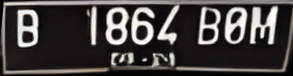

379
-0.1575288572629887 



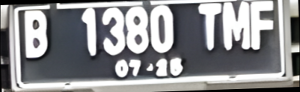

380
-178.56790381583534 



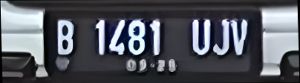

381
-176.2071653196099 



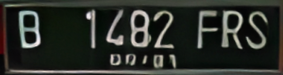

382
-9.847591494878259 



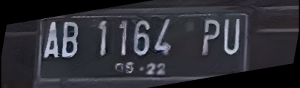

383
-179.2738944462709 



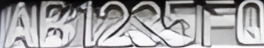

384
-10.603564346433387 



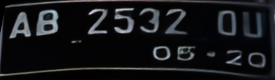

385
-0.4166892317935691 



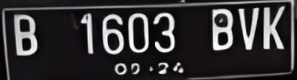

386
-178.56790381583534 



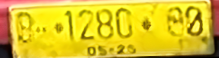

387
-149.8630026837339 



388
-0.03183098534358919 



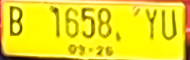

389
-0.1498697219197851 



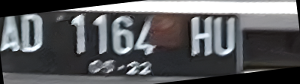

390
-6.446020838190279 



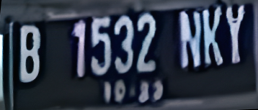

391
-1.6362754768558148 



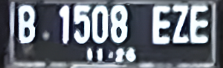

392
-179.99832328404483 



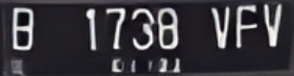

393
-179.3973207227606 



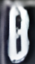

394
-13.952477768084933 



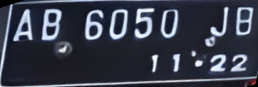

395
-11.026776394627774 



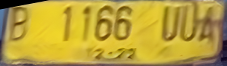

396
-176.7159724238073 



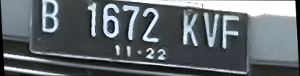

397
-15.75062172246679 



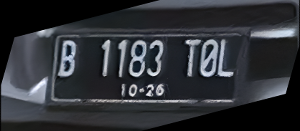

398
-5.267288373932786 



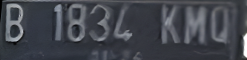

399
-4.907396853405672 



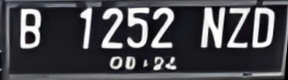

400
-179.94241989357096 



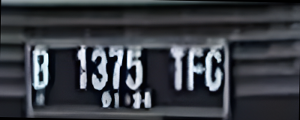

401
-8.860644833634353 



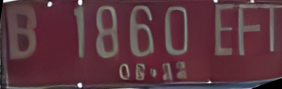

402
-2.9565834514125697 



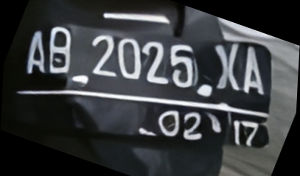

403
-179.52020587214375 



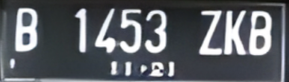

404
-178.80791427581113 



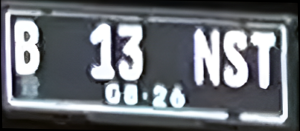

405
-7.75072570902374 



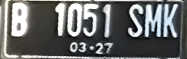

406
-5.073130790904713 



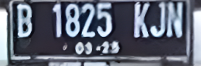

407
-172.80946127770207 



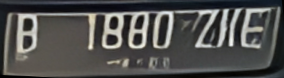

408
-162.7781125466188 



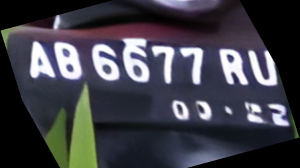

409
-178.68234905380785 



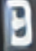

410
-0.8889388313185975 



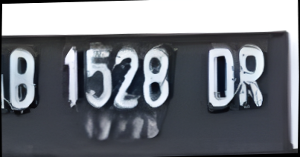

411
-178.56790381583534 



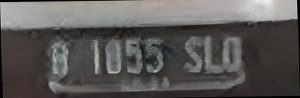

412
-173.82199498661095 



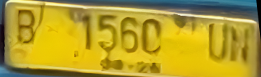

413
-179.20902643026622 



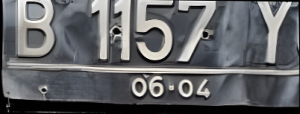

414
-178.9791568679206 



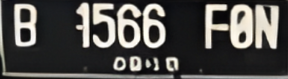

415
-4.944358231933052 



416
-1.8061360549196195 



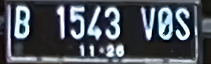

417
-1.9555367403278865 



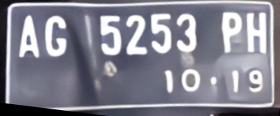

418
-13.189535520247802 



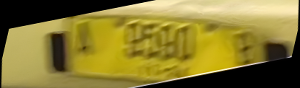

419
-178.0908475670036 



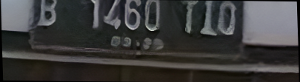

420
-148.7362683056226 



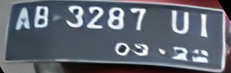

421
-178.04957535252262 



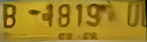

422
-175.35923171367756 



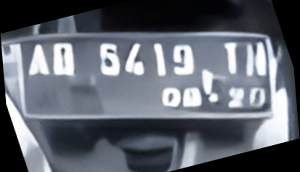

423
-3.187042125555024 



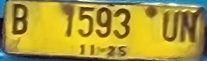

424
-3.65004676917259 



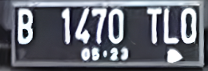

425
-176.72951207681643 



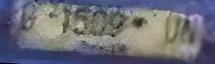

426
-1.6394221604728472 



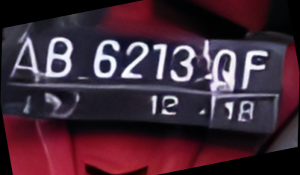

427
-8.39820467360046 



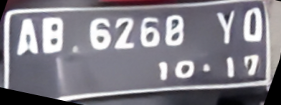

428
-178.2867531066234 



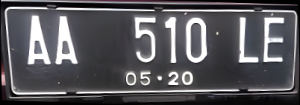

429
-0.28033591994315543 



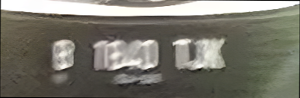

430
-0.03222640122768894 



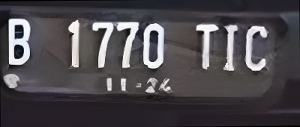

431
-5.897891388157504 



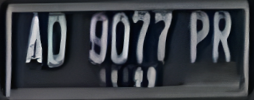

432
-0.18030429195071918 



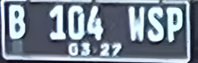

433
-172.993531583859 



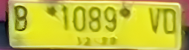

434
-9.158746632275964 



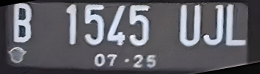

435
-0.758198817374307 



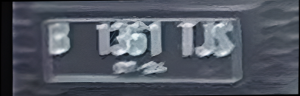

436
-0.048282948834653894 



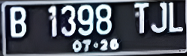

437
-179.9567220612882 



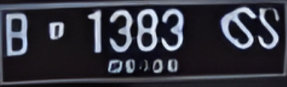

438
-179.98642994721115 



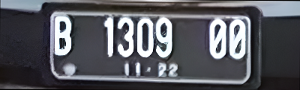

439
-0.9353581957571464 



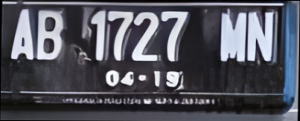

440
-0.49391689861874966 



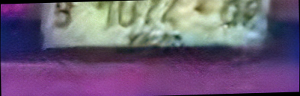

441
-1.6778814113993405 



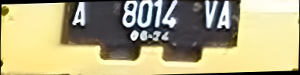

442
-1.3127984969750202 



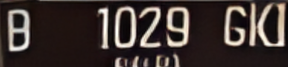

443
-2.2805151034733484 



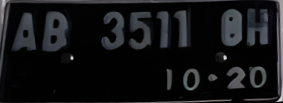

444
-178.55500749402356 



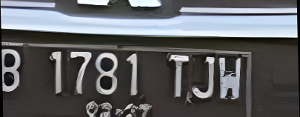

445
-2.7239716007371584 



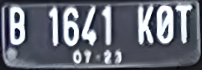

446
-179.56023839817118 



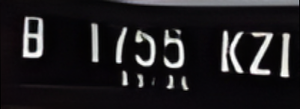

447
-4.74876538587128 



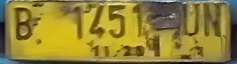

448


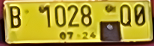

449
-179.73976449453772 



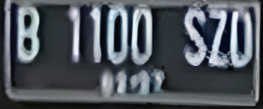

450
-0.09549287743587342 



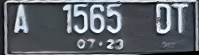

451
-4.98444464115768 



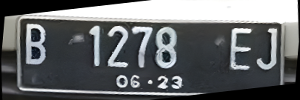

452
-179.9795372224725 



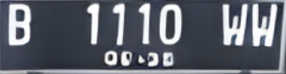

453
-172.8749836510982 



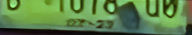

454
-179.76724136248146 



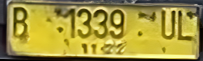

455
-12.217510498930963 



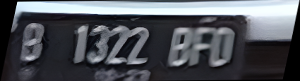

456
-0.11018405554297317 



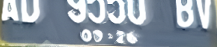

457
-178.28543966533238 



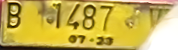

458
-179.9814730948534 



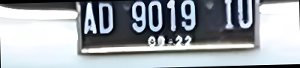

459
-1.8189954498418075 



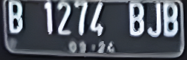

460
-169.23089240473172 



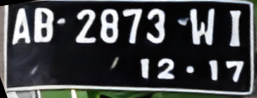

461
-0.7920570921623948 



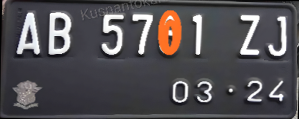

462
-4.823985531386995 



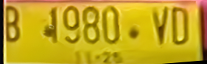

463
-1.7319661270893505 



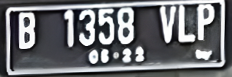

464
-0.6510603802294952 



465
-0.011234466427211487 



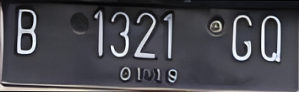

466
-179.71111616471939 



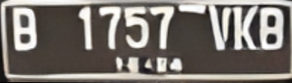

467
-1.665785310391101 



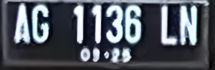

468
-5.398419509223189 



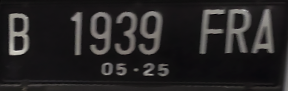

469
-179.9517555208297 



470
-173.05134563204427 



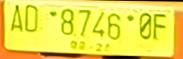

471
-13.824940578963293 



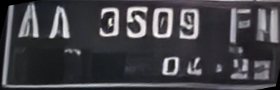

472
-175.85388976261373 



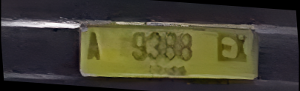

473
-3.7621424838311697 



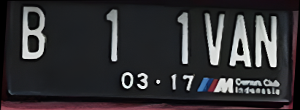

474
-175.0374337997151 



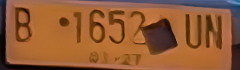

475
-3.2055868182924314 



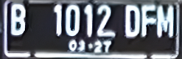

476
-2.181641403551467 



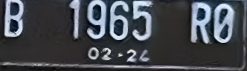

477
-8.124558635418992 



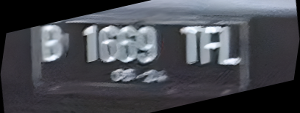

478
-173.45823106633514 



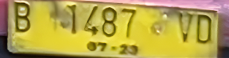

479
-9.067147300437782 



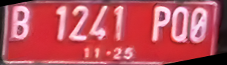

480
-9.067147300437782 



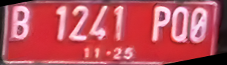

481
-179.99638284220725 



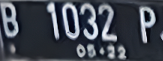

482
-179.89163931687818 



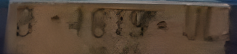

483
-176.96832973273342 



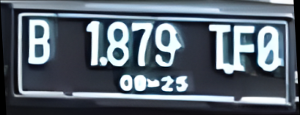

484
-176.21494764312976 



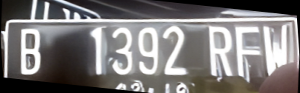

485
-179.33693915274347 



486
-2.9474478061328284 



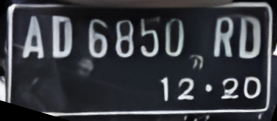

487
-6.202564818231863 



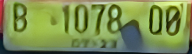

488
-170.07585078266072 



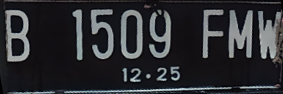

489
-0.3533031160980187 



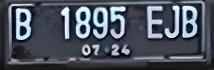

490
-0.009478209923969416 



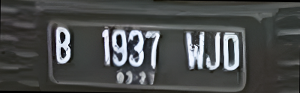

491
-177.2703521278863 



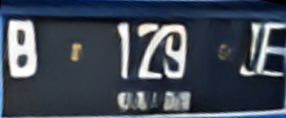

492
-171.34816598341985 



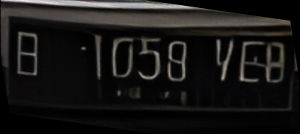

493
-3.7708588374222813 



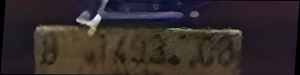

494
-0.8725429654866019 



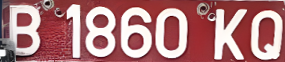

495
-0.8550973962667143 



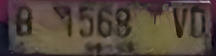

496
-10.266980537916751 



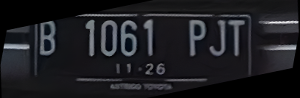

497
-178.16126636335994 



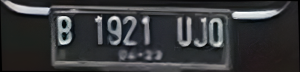

498


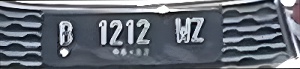

499
-5.37272832208248 



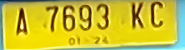

500
-7.474747230613119 



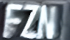

501
-11.289256887734936 



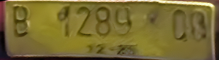

502
-1.8519803773236845 



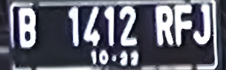

503
-4.011126101017837 



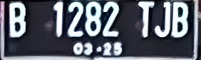

504


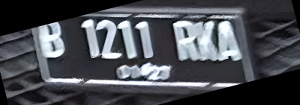

505
-1.7790696576858807 



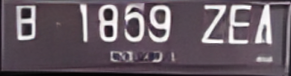

506
-179.85484181729976 



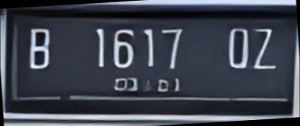

507
-0.10851460417889314 



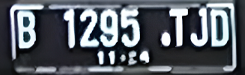

508
-4.462913664285296 



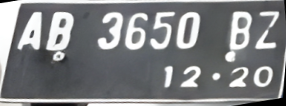

509
-171.71711330654065 



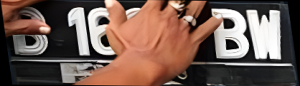

510
-9.019915532416164 



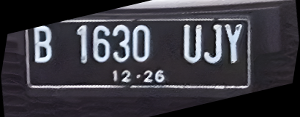

511
-179.8557428073633 



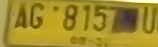

512
-176.53108811462073 



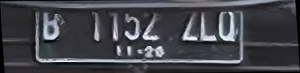

513
-178.8645097503619 



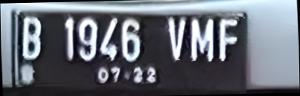

514
-3.286422184100843 



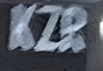

515
-179.93646639956398 



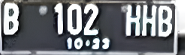

516
-5.917671980527857 



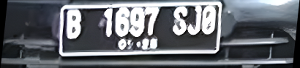

517
-2.5174806724920415 



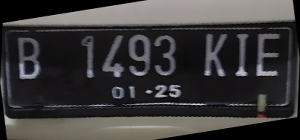

518
-178.56790381583534 



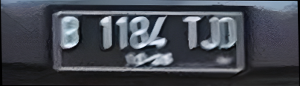

519
-178.97286213479936 



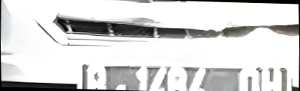

520


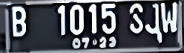

521
-0.08569875160270612 



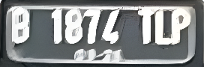

522
-179.94594739385337 



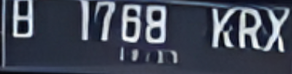

523
-8.16987231203376 



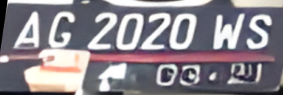

524
-17.227605093813864 



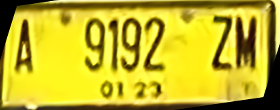

525
-2.825923496909283 



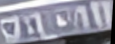

526
-167.3598236089188 



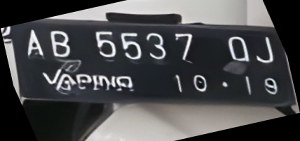

527
-179.7936668100105 



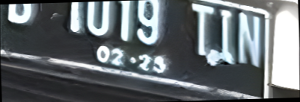

528
-4.193269497199921 



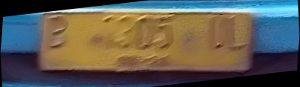

529
-18.794723150357015 



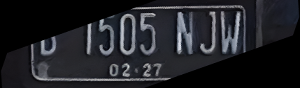

530
-179.35243159947615 



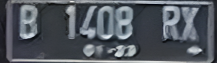

531
-11.3876622717911 



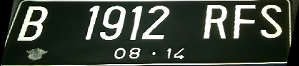

532
-179.8433322433513 



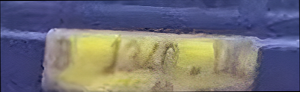

533
-4.694461441772404 



534
-175.88045314856387 



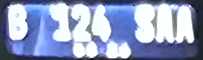

535
-13.910867606024098 



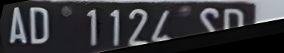

536
-2.4918551592910063 



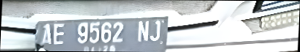

537
-23.422504378517985 



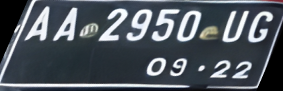

538
-4.368277434588393 



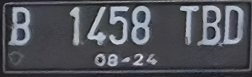

539
-1.1092649607392815 



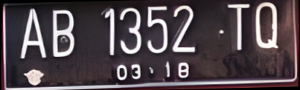

540
-0.19580685858468883 



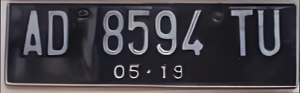

541
-10.414417540797743 



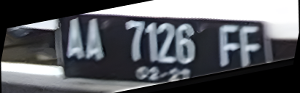

542
-3.766790888052057 



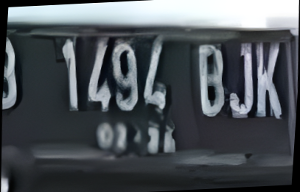

543
-12.215419010093939 



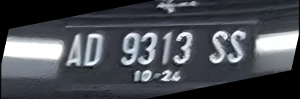

544
-25.114930176320996 



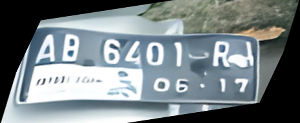

545
-0.6152906620005894 



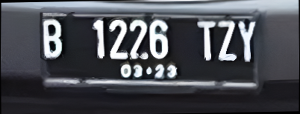

546
-1.101706115206369 



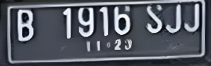

547
-0.31442490192181083 



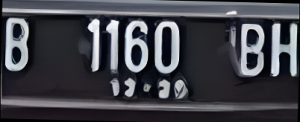

548
-3.943470736814092 



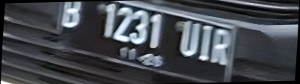

549
-176.9476090450069 



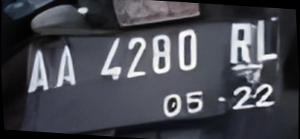

550
-9.364469592610305 



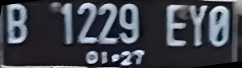

551
-172.68701375499575 



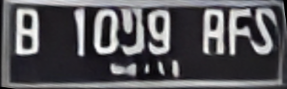

552
-0.5692662561994837 



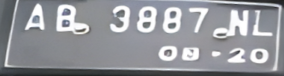

553
-179.92360567258658 



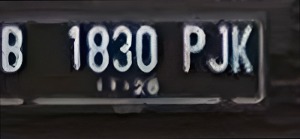

554
-4.728774340998356 



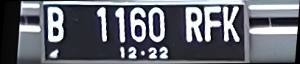

555
-1.832313377967239 



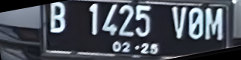

556
-179.9503678636185 



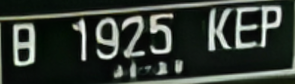

557
-0.2785189565863959 



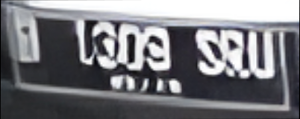

558
-166.18204401161177 



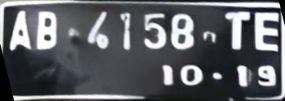

559
-178.92032273815204 



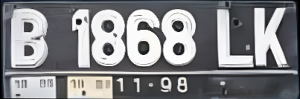

560
-0.09262350518561391 



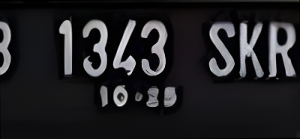

561
-3.0953997886015117 



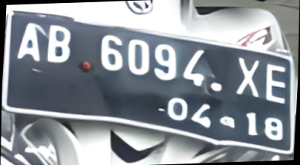

562
-179.11168714472805 



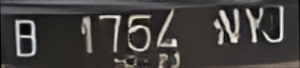

563
-179.68288776040202 



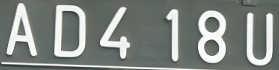

564
-5.8828004749686045 



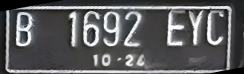

565
-178.04064537226884 



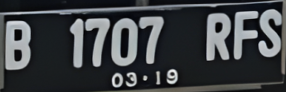

566
-173.10693932029727 



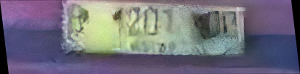

567
-179.73883213717124 



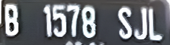

568
-30.932539481924422 



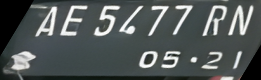

569
-178.56790381583534 



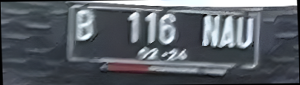

570
-2.294980102078924 



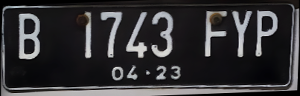

571
-0.7983927319416182 



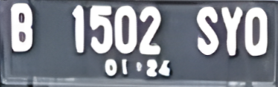

572
-178.06835093327868 



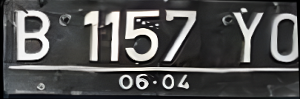

573
-1.1813144292933373 



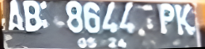

574
-179.46027311459272 



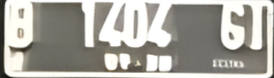

575
-179.91806223557984 



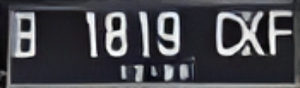

576
-4.2392067964805875 



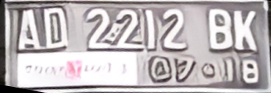

577
-175.24325041275162 



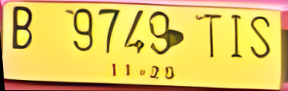

578
-7.337698570867289 



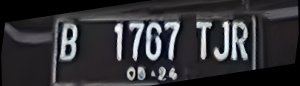

579
-5.8838632036625995 



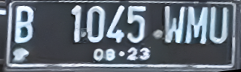

580
-6.1987420252937255 



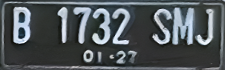

581
-161.5875455352147 



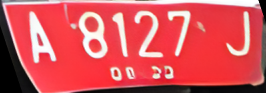

582
-179.8626473670219 



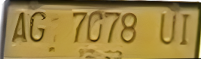

583
-1.1171261191244497 



584
-2.0787352760124946 



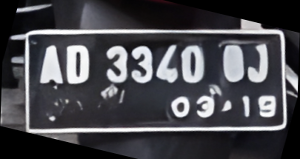

585
-9.43984201144967 



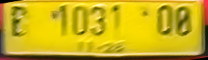

586
-16.159928669578846 



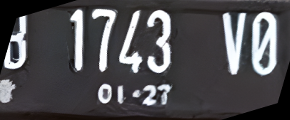

587
-173.6742689871097 



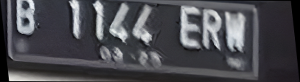

588
-6.904366170726362 



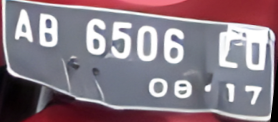

589
-1.000052446471571 



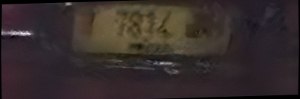

590
-4.49642293591215 



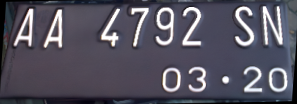

591
-178.29908421424426 



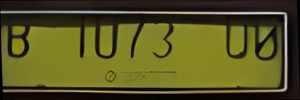

592
-175.0103750532067 



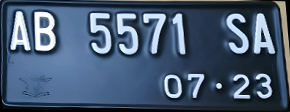

593
-179.73142800060097 



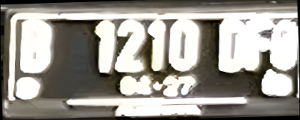

594
-0.05729576041449036 



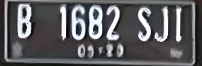

595
-179.83166352532203 



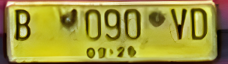

596
-179.6648376251174 



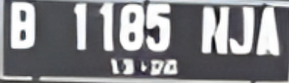

597
-177.9794241013378 



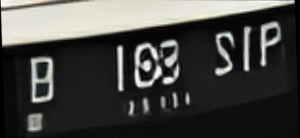

598
-179.85281397857827 



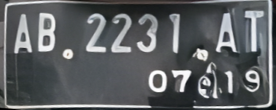

599
-169.63545663044425 



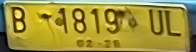

600
-0.04283475541159021 



601
-9.184603949176164 



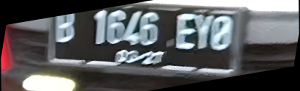

602
-25.033561230854758 



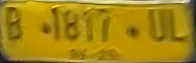

603
-177.0143507672618 



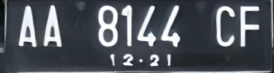

604
-168.15072007170363 



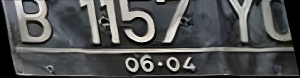

605
-6.742142978804807 



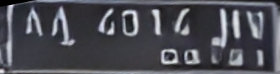

606
-0.22371832527187507 



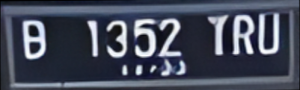

607
-178.67305372730203 



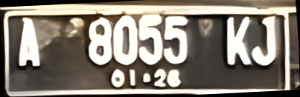

608
-0.08952458263394192 



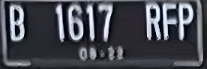

609
-177.2162386694623 



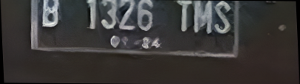

610
-0.16906902260480194 



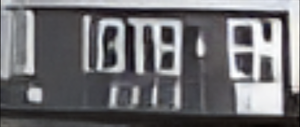

611
-0.4774537773095773 



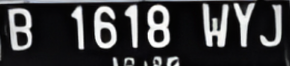

612


In [ ]:
# Mendefinisikan path untuk hasil proses ERSGAN yang telah diekstrak
image_folder_path = '/content/DataTrain/ERESGAN_Train'

# Membuat list file yang bertipe .png
png_files = [file for file in os.listdir(image_folder_path) if file.lower().endswith('.png')]

# Melakukan iterasi untuk setiap file .png
for dian in range (0,len(png_files)):

    # Membaca setiap gambar
    image = cv2.imread('/content/DataTrain/ERESGAN_Train/'+str(png_files[dian]))

    # Melakukan proses contrast streching pada gambar
    image = contrast_stretching(image)

    # Melakukan resize gambar agar tidak terlalu besar atau kecil
    resized_image = resize_image(image)

    # Mendeteksi tepian gambar dengan canny
    edges = detect_edges(resized_image)

    # Mendeteksi tepian horizontal dari gambar
    lines = detect_lines(edges, threshold1=25, threshold2=10, min_line_length=15, max_line_gap=10)

    # Membuat copy dari gambar yang telah di resize
    rgb_image = resized_image.copy()

    # Mengkoleksi semua tepian horizontal dari gambar
    result = rgb_image.copy()

    # Jika terdapat tepian yang terdeteksi, maka simpan dalam list
    green_slopes = []
    if lines is not None:
        for line in lines:
            x1, y1, x2, y2 = line[0]

            # Jika kemiringannya Kurang dari 45derajat maka merupakan tepian horizotal
            if abs(y2 - y1) <= abs(x2 - x1):
                cv2.line(result, (x1, y1), (x2, y2), (0, 255, 0), 2)
                slope = (y2 - y1) / (x2 - x1)
                green_slopes.append(slope)

    # Mencari modus dari hasil clustering dari kemiringan horizontal
    slope_horizontal = average_middle_value(green_slopes)

    # Jika terdapat kemiringan yang horizontal, maka:
    if green_slopes:

        # Hitung sudut kemiringan horizontalnya
        angle = np.degrees(np.arctan(slope_horizontal))

        # Buat rotasi transformasi matriksnya
        center = (resized_image.shape[1] // 2, resized_image.shape[0] // 2)
        M = cv2.getRotationMatrix2D(center, angle, 1.0)

        # Lakukan rotasi gambar
        resized_image = cv2.warpAffine(resized_image, M, (resized_image.shape[1], resized_image.shape[0]))

    # Rotasi gambar ke 90derajat
    rotated_image = rotated_90(resized_image)

    # Convert gambar menuju Numpy Array
    rotated_image = np.array(rotated_image)

    # Mendeteksi tepian gambar dengan canny
    new_edges = detect_edges(rotated_image)
    new_lines = detect_lines(new_edges, threshold1=25, threshold2=15, min_line_length=15, max_line_gap=25)

    # Membuat copy dari gambar yang telah di rotasi
    rgb_image = rotated_image.copy()

    # Mengkoleksi semua tepian vertikal dari gambar
    result = rgb_image.copy()

    # Jika terdapat tepian yang terdeteksi, maka simpan dalam list
    red_slopes = []
    if lines is not None:
        for line in new_lines:
            x1, y1, x2, y2 = line[0]

            # Jika kemiringannya kurang dari 45derajat maka merupakan tepian vertikal
            if abs(y2 - y1) < abs(x2 - x1):
                cv2.line(result, (x1, y1), (x2, y2), (0, 0, 255), 2)
                slope = (y2 - y1) / (x2 - x1)
                red_slopes.append(slope)

    # Memvisualisasikan distribusi kemiringan vertikal
    slope_vertical = average_middle_value(red_slopes, bins = 20)

    # Membuat duplikat dari gambar yang telah dirotasi
    rgb_image = rotated_image.copy()

    # Menambahkan border hitam di dalam gambar
    image_with_border = add_black_border(rgb_image, border_size = rgb_image.shape[1])

    # Jika terdapat kemiringan vertikal yang kemiringannya 0, maka ubah ke 0.0001 agar tidak ada zero divisor
    if red_slopes:
        if slope_vertical == 0:
            slope_vertical = 0.0001

        # Menghitung kemiringan sesungguhnya
        real_slope = -1/slope_vertical

        # Mengubah kedalam derajat
        angle = math.degrees(math.atan(real_slope))
        real_angle = -(90 - angle)
        print(real_angle,'\n')

        # Mentransformasi gambar sesuai dengan kemiringannya
        transformed_image = transform_image(image_with_border, angle = real_angle)

        # Merotasi gambar menuju 270derajat
        for i in range(3):
            transformed_image = rotated_90(transformed_image)

    # Jika terdapat kemiringan vertikal, maka:
    if red_slopes:
        # Konversi gambar menjadi grayscale
        gray_transformed_image = cv2.cvtColor(transformed_image, cv2.COLOR_BGR2GRAY)

        # Hitung presentasi dari piksel abu dan piksel hitam
        total_pixels = gray_transformed_image.shape[0] * gray_transformed_image.shape[1]
        black_pixels = np.count_nonzero(gray_transformed_image == 0)
        percentage_black = (black_pixels / total_pixels) * 100

    # Jika ada kemiringan vertikal dan presentase piksel hitamnya sedikit, maka:
    if red_slopes and percentage_black < 90:
        # Lakukan pemotongan bagian hitam
        resized_image = crop_black(transformed_image)

        # Konversi gambar menuju Numpy array
        resized_image = np.array(resized_image)

    # Mengitung ukuran panjang dan tinggi gambar
    height, width = resized_image.shape[:2]

    # Mendefinisikan target lebar gambar yang diinginkan
    target_width = 300

    # Menghitung rasio perbesaran gambar
    ratio = target_width / float(width)

    # Menghitung tinggi gambar berdasarkan rasio perbesaran gambar
    target_height = int(height * ratio)

    # Resize gambarnya dengan menggunakan interpolasi berdasarkan tinggi yang diharapkan
    resized_image = cv2.resize(resized_image, (target_width, target_height), interpolation=cv2.INTER_CUBIC)

    # Mengkonversi gambar menjadi format PIL
    image = Image.fromarray(resized_image)

    # Memunculkan pre-trained YOLOS feature extractor dan model untuk deteksi plat nomor model
    feature_extractor = YolosFeatureExtractor.from_pretrained('nickmuchi/yolos-small-finetuned-license-plate-detection')
    model = YolosForObjectDetection.from_pretrained('nickmuchi/yolos-small-finetuned-license-plate-detection')

    # Menyiapkan input gambar untuk inferensi model
    inputs = feature_extractor(images=image, return_tensors="pt")

    # Hasil output dari pre trained modelnya
    outputs = model(**inputs)

    # Model memprediksi bounding boxnya
    logits = outputs.logits
    bboxes = outputs.pred_boxes

    # Mengkonversi output ke COCO API
    target_sizes = torch.tensor([image.size[::-1]])
    results = feature_extractor.post_process_object_detection(outputs, threshold=0.5, target_sizes=target_sizes)[0]

    # Membuat salinan dari gambar
    image_cv = np.array(image)
    image = image_cv.copy()

    # Melakukan iterasi dari keseluruhan bounding box
    for score, label, box in zip(results["scores"], results["labels"], results["boxes"]):
        box = [int(i) for i in box.tolist()]
        # Menggambar bounding boxnya ke dalam gambar
        cv2.rectangle(image_cv, (box[0], box[1]), (box[2], box[3]), (0, 255, 0), 2)
        # Menambahkan label dan skor kepercayaan dari model
        label_text = f'{model.config.id2label[label.item()]}: {round(score.item(), 3)}'

    # Melist skor kepercayaan
    confidence = results['scores'].tolist()

    # Jika ada bounding boxnya dan skor kepercayaannya lebih dari 90 maka:
    if len(confidence) > 0:
        if max(confidence) > 0.9:

            # Crop gambar berdasarkan bounding boxnya
            cropped_images = []
            for box in results["boxes"]:
                box = [int(i) for i in box.tolist()]
                cropped_image = image[box[1]:box[3], box[0]:box[2]]
                cropped_images.append(cropped_image)

            # Konversi gambar yang telah di crop ke dalam Numpy array
            resized_image = np.array(cropped_image)

    # Tampilkan gambar hasil preprocessing
    cv2_imshow(resized_image)

    # Print iterasi dan simpan gambar
    print(dian)
    cv2.imwrite('/content/DataTrain/Rotasi_Train/'+str(png_files[dian]), resized_image)

###**Proses Rotating tanpa Cropping**

Melakukan proses yang sama namun tidak melakukan pemotongan gambar yang menghasilkan hasil pemotongan yang jelek

-0.04283475541159021 



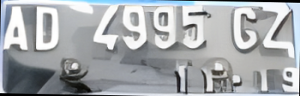

601
-1.1171261191244497 



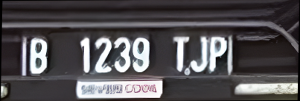

584
-4.694461441772404 



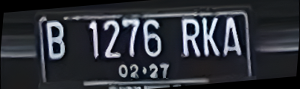

534
-2.825923496909283 



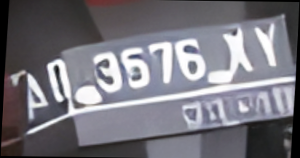

526
-3.286422184100843 



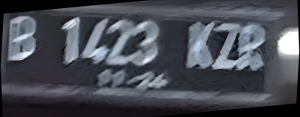

515
-7.474747230613119 



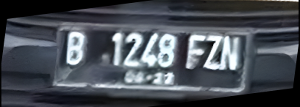

501
-179.33693915274347 



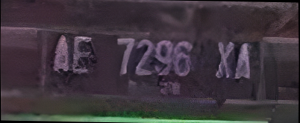

486
-179.9517555208297 



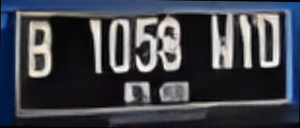

470
-0.6510603802294952 



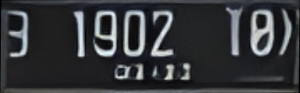

465
-172.8749836510982 



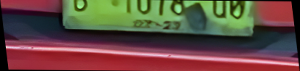

454
-4.944358231933052 



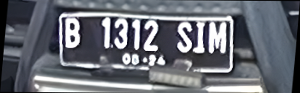

416
-178.68234905380785 



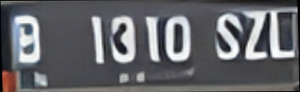

410
-179.3973207227606 



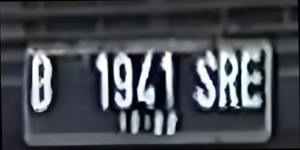

394
-149.8630026837339 



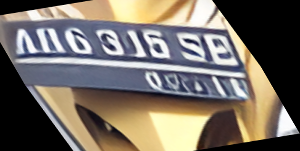

388
-1.12729590279325 



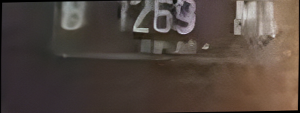

347
-0.02137902121417312 



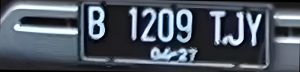

236
-179.8595694490627 



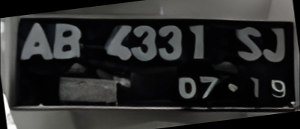

228
-166.52507251944385 



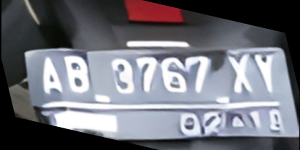

202
-160.9533757023642 



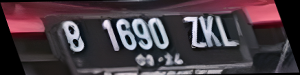

74
-0.1273237448873772 



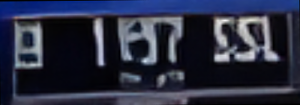

50
-0.030870567871119192 



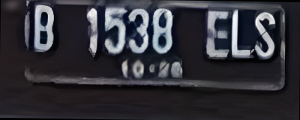

29


In [ ]:
# List gambar yang perlu dilakukan proses rotating tanpa cropping
buruk = [601, 584, 534, 526, 515, 501, 486, 470, 465, 454, 416, 410, 394, 388, 347, 236, 228, 202, 74, 50, 29]

# Lakukan iterasi di setiap gambar dalam list
for dian in buruk:
    # Membaca setiap gambar
    image = cv2.imread('/content/DataTrain/ERESGAN_Train/'+str(png_files[dian]))

    # Melakukan proses contrast streching pada gambar
    image = contrast_stretching(image)

    # Melakukan resize gambar agar tidak terlalu besar atau kecil
    resized_image = resize_image(image)

    # Mendeteksi tepian gambar dengan canny
    edges = detect_edges(resized_image)

    # Mendeteksi tepian horizontal dari gambar
    lines = detect_lines(edges, threshold1=25, threshold2=10, min_line_length=15, max_line_gap=10)

    # Membuat copy dari gambar yang telah di resize
    rgb_image = resized_image.copy()

    # Mengkoleksi semua tepian horizontal dari gambar
    result = rgb_image.copy()
    green_slopes = []

    # Jika terdapat tepian yang terdeteksi, maka simpan dalam list
    if lines is not None:
        for line in lines:
            x1, y1, x2, y2 = line[0]
            if abs(y2 - y1) <= abs(x2 - x1):
                cv2.line(result, (x1, y1), (x2, y2), (0, 255, 0), 2)
                slope = (y2 - y1) / (x2 - x1)
                green_slopes.append(slope)

    # Mencari modus dari hasil clustering dari kemiringan horizontal
    slope_horizontal = average_middle_value(green_slopes)

    # Jika terdapat kemiringan yang horizontal, maka:
    if green_slopes:

        # Hitung sudut kemiringan horizontalnya
        angle = np.degrees(np.arctan(slope_horizontal))

        # Buat rotasi transformasi matriksnya
        center = (resized_image.shape[1] // 2, resized_image.shape[0] // 2)
        M = cv2.getRotationMatrix2D(center, angle, 1.0)

        # Lakukan rotasi gambar
        resized_image = cv2.warpAffine(resized_image, M, (resized_image.shape[1], resized_image.shape[0]))

    # Rotasi gambar ke 90derajat
    rotated_image = rotated_90(resized_image)

    # Convert gambar menuju Numpy Array
    rotated_image = np.array(rotated_image)

    # Mendeteksi tepian gambar dengan canny
    new_edges = detect_edges(rotated_image)
    new_lines = detect_lines(new_edges, threshold1=25, threshold2=15, min_line_length=15, max_line_gap=25)

    # Membuat copy dari gambar yang telah di rotasi
    rgb_image = rotated_image.copy()

    # Mengkoleksi semua tepian vertikal dari gambar
    result = rgb_image.copy()
    red_slopes = []

    # Jika terdapat tepian yang terdeteksi, maka simpan dalam list
    if lines is not None:
        for line in new_lines:
            x1, y1, x2, y2 = line[0]

            # Jika kemiringannya kurang dari 45derajat maka merupakan tepian vertikal
            if abs(y2 - y1) < abs(x2 - x1):
                cv2.line(result, (x1, y1), (x2, y2), (0, 0, 255), 2)
                slope = (y2 - y1) / (x2 - x1)
                red_slopes.append(slope)

    # Memvisualisasikan distribusi kemiringan vertikal
    slope_vertical = average_middle_value(red_slopes, bins = 20)

    # Membuat duplikat dari gambar yang telah dirotasi
    rgb_image = rotated_image.copy()

    # Menambahkan border hitam di dalam gambar
    image_with_border = add_black_border(rgb_image, border_size = rgb_image.shape[1])

    # Jika terdapat kemiringan vertikal yang kemiringannya 0, maka ubah ke 0.0001 agar tidak ada zero divisor
    if red_slopes:
        if slope_vertical == 0:
            slope_vertical = 0.0001

        # Menghitung kemiringan sesungguhnya
        real_slope = -1/slope_vertical

        # Mengubah kedalam derajat
        angle = math.degrees(math.atan(real_slope))
        real_angle = -(90 - angle)
        print(real_angle,'\n')

        # Mentransformasi gambar sesuai dengan kemiringannya
        transformed_image = transform_image(image_with_border, angle = real_angle)

        # Merotasi gambar menuju 270derajat
        for i in range(3):
            transformed_image = rotated_90(transformed_image)

    # Jika terdapat kemiringan vertikal, maka:
    if red_slopes:

        # Konversi gambar menjadi grayscale
        gray_transformed_image = cv2.cvtColor(transformed_image, cv2.COLOR_BGR2GRAY)

        # Hitung presentasi dari piksel abu dan piksel hitam
        total_pixels = gray_transformed_image.shape[0] * gray_transformed_image.shape[1]
        black_pixels = np.count_nonzero(gray_transformed_image == 0)
        percentage_black = (black_pixels / total_pixels) * 100

    # Jika ada kemiringan vertikal dan presentase piksel hitamnya sedikit, maka:
    if red_slopes and percentage_black < 90:

        # Lakukan pemotongan bagian hitam
        resized_image = crop_black(transformed_image)

        # Konversi gambar menuju Numpy array
        resized_image = np.array(resized_image)

    # Mengitung ukuran panjang dan tinggi gambar
    height, width = resized_image.shape[:2]

    # Mendefinisikan target lebar gambar yang diinginkan
    target_width = 300

    # Menghitung rasio perbesaran gambar
    ratio = target_width / float(width)

    # Menghitung tinggi gambar berdasarkan rasio perbesaran gambar
    target_height = int(height * ratio)

    # Resize gambarnya dengan menggunakan interpolasi berdasarkan tinggi yang diharapkan
    resized_image = cv2.resize(resized_image, (target_width, target_height), interpolation=cv2.INTER_CUBIC)

    # Mengkonversi gambar menjadi format PIL
    image = Image.fromarray(resized_image)

    # Menampilkan gambar hasil preprocessing
    cv2_imshow(resized_image)

    # Mengeprint iterasi
    print(dian)

    # Menyimpan gambar hasil preprocessing
    cv2.imwrite('/content/DataTrain/Rotasi_Train/'+str(png_files[dian]), resized_image)

#**Test Set**

### **Mengekstrak File untuk Test Set**

In [ ]:
# Mendefinisikan path dari file zip data test dan path untuk menyimpan hasil ekstraknya
zip_file_path = '/content/drive/MyDrive/BDC_Penyisihan/Data Test for BDC 2023 - Penyisihan.zip'
extract_path = '/content/DataTest'

# Membaca file zip dari data test
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    # Mengekstract semua konten dari file zip ke extract path
    zip_ref.extractall(extract_path)

# Notifikasi bahwa file berhasil di ekstrak
print("File berhasil diekstrak")

File successfully extracted.


In [ ]:
# Nama folder untuk upload dan hasil
upload_folder = 'upload'
result_folder = 'results'

# Menghapus folder jika sudah ada
if os.path.isdir(upload_folder):
    shutil.rmtree(upload_folder)
if os.path.isdir(result_folder):
    shutil.rmtree(result_folder)

# Membuat folder baru untuk upload dan hasil
os.mkdir(upload_folder)
os.mkdir(result_folder)

# Path folder gambar
image_folder_path = '/content/DataTest/Data Test for BDC 2023 - Penyisihan'
png_files = [file for file in os.listdir(image_folder_path) if file.lower().endswith('.png')]

# Mengunggah gambar-gambar
for filename in png_files:
    file_path = os.path.join(image_folder_path, filename)
    dst_path = os.path.join(upload_folder, filename)
    shutil.copy(file_path, dst_path)
    print(f'Moved {filename} to {dst_path}')

# Menampilkan daftar file yang diunggah
uploaded_files = os.listdir(upload_folder)
print(f"Uploaded files: {uploaded_files}")

Moved DataTest16.png to upload/DataTest16.png
Moved DataTest49.png to upload/DataTest49.png
Moved DataTest74.png to upload/DataTest74.png
Moved DataTest67.png to upload/DataTest67.png
Moved DataTest78.png to upload/DataTest78.png
Moved DataTest80.png to upload/DataTest80.png
Moved DataTest75.png to upload/DataTest75.png
Moved DataTest26.png to upload/DataTest26.png
Moved DataTest12.png to upload/DataTest12.png
Moved DataTest27.png to upload/DataTest27.png
Moved DataTest9.png to upload/DataTest9.png
Moved DataTest52.png to upload/DataTest52.png
Moved DataTest8.png to upload/DataTest8.png
Moved DataTest15.png to upload/DataTest15.png
Moved DataTest3.png to upload/DataTest3.png
Moved DataTest55.png to upload/DataTest55.png
Moved DataTest19.png to upload/DataTest19.png
Moved DataTest50.png to upload/DataTest50.png
Moved DataTest73.png to upload/DataTest73.png
Moved DataTest14.png to upload/DataTest14.png
Moved DataTest35.png to upload/DataTest35.png
Moved DataTest1.png to upload/DataTest1.

In [ ]:
# Jika terjadi masalah kehabisan memori, coba gunakan opsi `--tile`
# Kami melakukan peningkatan ukuran pada gambar dengan faktor skala X3.5
!python inference_realesrgan.py -n RealESRGAN_x4plus -i upload --outscale 3.5 --face_enhance
# Argumen
# -n, --model_name: Nama model
# -i, --input: folder masukan atau gambar
# --outscale: Skala keluaran, dapat berupa faktor skala sembarang.

/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional_tensor.py:5: UserWarning: The torchvision.transforms.functional_tensor module is deprecated in 0.15 and will be **removed in 0.17**. Please don't rely on it. You probably just need to use APIs in torchvision.transforms.functional or in torchvision.transforms.v2.functional.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


###**Preparing a Test Data After ERSGAN Process**

In [ ]:
# Mendefinisikan path dari hasil proses ERSGAN dan path untuk menyimpan hasil ekstrak dari file zipnya
zip_file_path = '/content/DataTest/ERESGAN_DataTest/Real-ESRGAN_DataTest.zip'
extract_path = '/content/DataTest/ERESGAN_DataTest'

# Membuka file zip
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    # Mengekstrak semua isi dari file zip ke dalam path ekstraksi yang telah ditentukan
    zip_ref.extractall(extract_path)

# Notifikasi untuk memastikan file berhasil diekstrak
print("File berhasil diekstrak.")

File successfully extracted.


-177.88647206520898 



/usr/local/lib/python3.10/dist-packages/transformers/models/yolos/feature_extraction_yolos.py:28: FutureWarning: The class YolosFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use YolosImageProcessor instead.
  warnings.warn(
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.


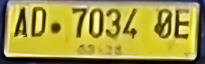

1
-175.85388976261373 



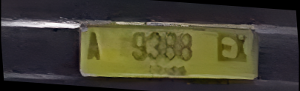

2
-0.9975978874990119 



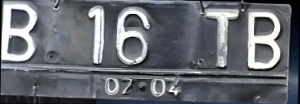

3
-178.56790381583534 



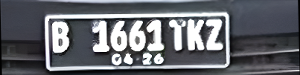

4
-151.3020050692832 



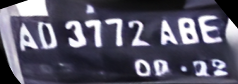

5
-2.5901859677828867 



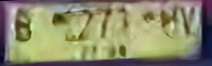

6
-23.096432129740293 



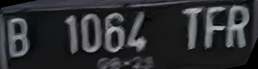

7
-2.0563543924956633 



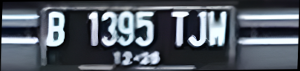

8
-10.831272223595676 



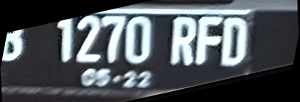

9
-0.08327869064665094 



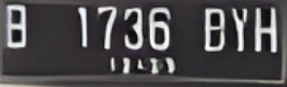

10
-0.18191543221634277 



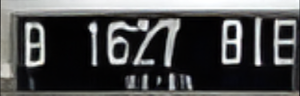

11
-179.94997312963466 



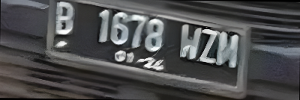

12
-12.215419010093939 



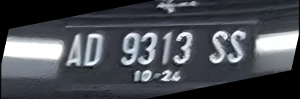

13
-178.45118101735474 



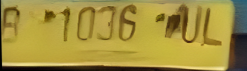

14
-6.862429131013357 



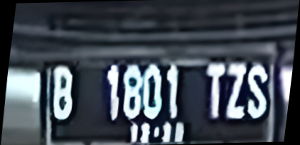

15
-1.4699780652438221 



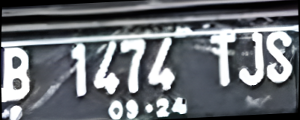

16
-30.887365490292417 



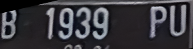

17
-179.9749866979884 



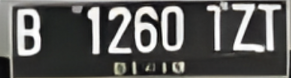

18
-1.3716087031911854 



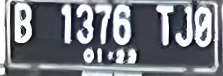

19
-178.56790381583534 



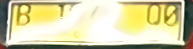

20
-25.15531653854613 



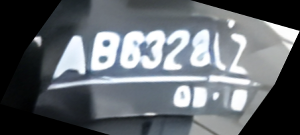

21
-0.323093076318159 



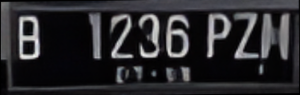

22
-1.1813144292933373 



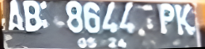

23
-174.61017506230434 



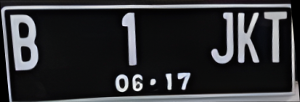

24


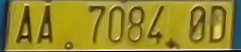

25
-6.15587621554333 



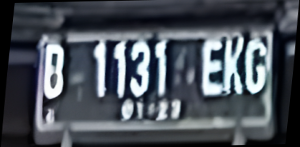

26
-176.76171760039375 



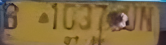

27
-179.91139834972864 



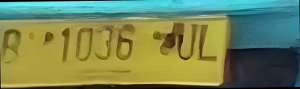

28
-0.08425843854404036 



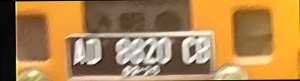

29
-17.227605093813864 



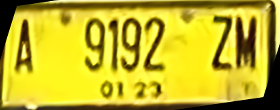

30
-179.91861400429252 



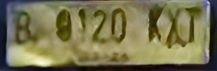

31
-179.95225352812486 



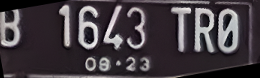

32
-144.24344205476626 



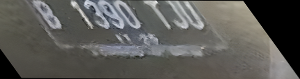

33
-137.57590181197628 



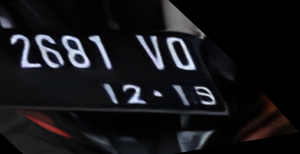

34
-3.2462981888528333 



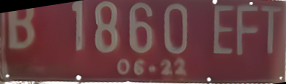

35
-169.39496246988085 



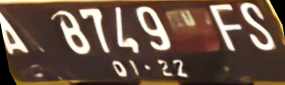

36
-179.94594739385337 



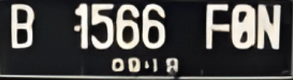

37
-1.265631097151342 



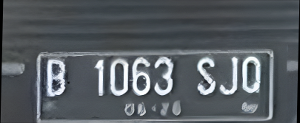

38
-1.8984347280552356 



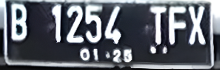

39
-1.3450938079597563 



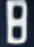

40
-170.72360178896525 



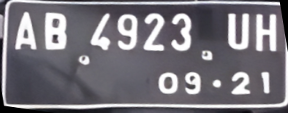

41
-9.475032008064048 



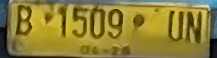

42
-179.26380146509837 



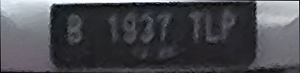

43
-14.84351397813252 



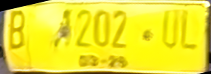

44
-8.248164802868914 



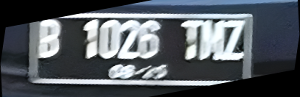

45
-3.771438946478824 



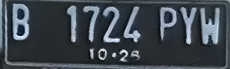

46
-1.2523705843941428 



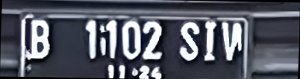

47
-179.2218849417672 



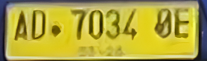

48
-0.5388372782053352 



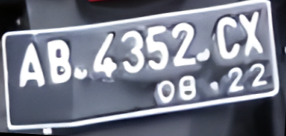

49
-0.650013128939321 



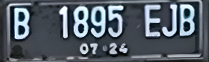

50
-143.59728978117028 



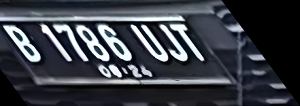

51


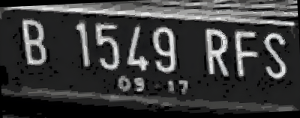

52
-7.278821550546681 



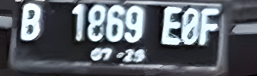

53
-175.53284093861072 



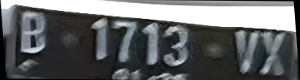

54
-13.170096653589397 



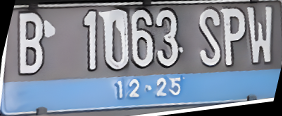

55
-179.41256176923585 



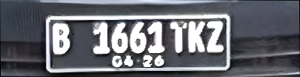

56
-1.6778814113993405 



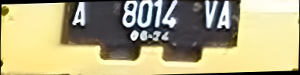

57
-2.862405226111747 



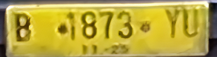

58
-3.13694584864092 



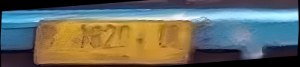

59
-2.719870045326388 



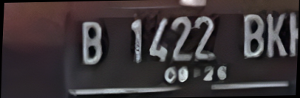

60
-155.3947589600265 



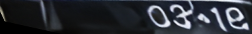

61
-1.0358411255068205 



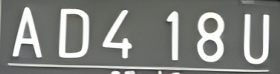

62
-179.34633055396336 



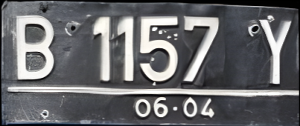

63
-1.1736035440682429 



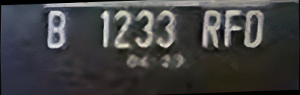

64
-179.95659411473332 



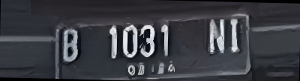

65
-174.51423793532365 



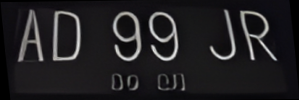

66
-3.19459927836391 



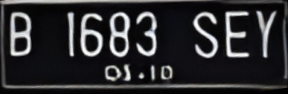

67
-0.8838519531592368 



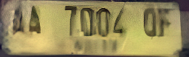

68
-0.05115693239982022 



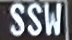

69
-178.56790381583534 



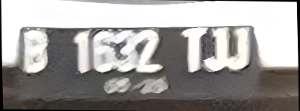

70
-179.28019203494918 



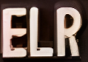

71
-0.5707352333560891 



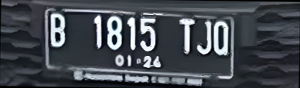

72
-3.2469952079973297 



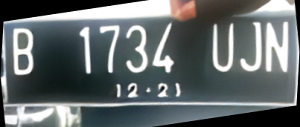

73
-2.713191826181088 



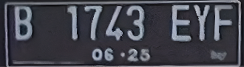

74
-174.78407066316666 



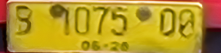

75
-177.17728565425125 



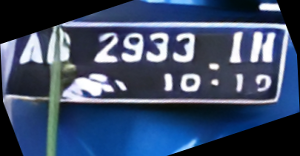

76
-2.549382786020388 



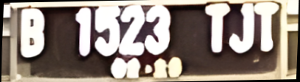

77
-172.69516225795175 



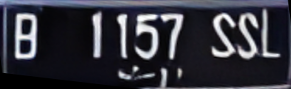

78
-175.53284093861072 



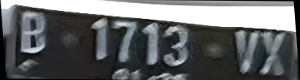

79
-0.758198817374307 



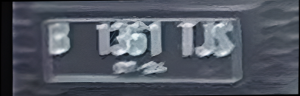

80
-177.09476949786946 



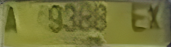

81
-6.446020838190279 



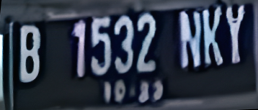

82
-179.61469604489324 



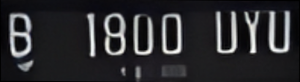

83
-0.312459534685118 



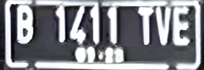

84
-179.74722614210845 



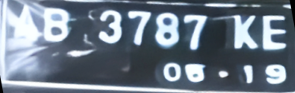

85
-0.017871211250678698 



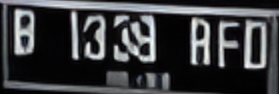

86
-178.73556873216938 



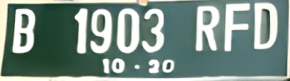

87
-6.055533236360077 



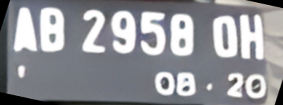

88
-179.84578812938565 



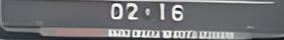

89
-176.70808176845628 



90
-0.3373983955431328 



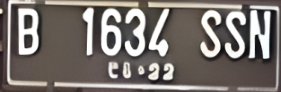

91
-6.637992405788154 



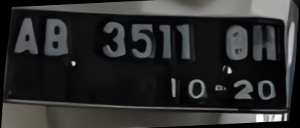

92
-5.449967485173147 



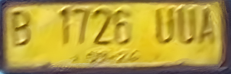

93
-175.63814061944709 



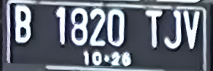

94
-2.2215299112796885 



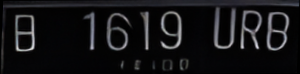

95
-178.15972503000512 



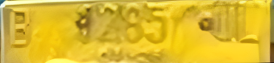

96
-2.5046502485057403 



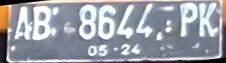

97
-1.393043526802316 



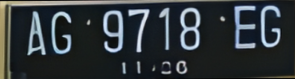

98
-9.475032008064048 



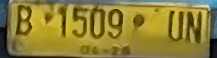

99
-179.35243159947615 



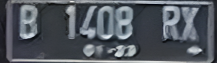

100


In [ ]:
# Melakukan iterasi untuk setiap file .png
for dian in range (1,101):

    # Membaca setiap gambar
    image = cv2.imread('/content/DataTest/ERESGAN_DataTest/DataTest'+str(dian)+'_out.png')

    # Melakukan proses contrast streching pada gambar
    image = contrast_stretching(image)

    # Melakukan resize gambar agar tidak terlalu besar atau kecil
    resized_image = resize_image(image)

    # Mendeteksi tepian gambar dengan canny
    edges = detect_edges(resized_image)
    lines = detect_lines(edges, threshold1=25, threshold2=10, min_line_length=15, max_line_gap=10)

    # Membuat copy dari gambar yang telah di resize
    rgb_image = resized_image.copy()

    # Mengkoleksi semua tepian horizontal dari gambar
    result = rgb_image.copy()

    # Jika terdapat tepian yang terdeteksi, maka simpan dalam list
    green_slopes = []
    if lines is not None:
        for line in lines:
            x1, y1, x2, y2 = line[0]

            # Jika kemiringannya Kurang dari 45derajat maka merupakan tepian horizontal
            if abs(y2 - y1) <= abs(x2 - x1):
                cv2.line(result, (x1, y1), (x2, y2), (0, 255, 0), 2)
                slope = (y2 - y1) / (x2 - x1)
                green_slopes.append(slope)

    # Mencari modus dari hasil clustering dari kemiringan horizontal
    slope_horizontal = average_middle_value(green_slopes)

    # Jika terdapat kemiringan yang horizontal, maka:
    if green_slopes:

        # Hitung sudut kemiringan horizontalnya
        angle = np.degrees(np.arctan(slope_horizontal))

        # Buat rotasi transformasi matriksnya
        center = (resized_image.shape[1] // 2, resized_image.shape[0] // 2)
        M = cv2.getRotationMatrix2D(center, angle, 1.0)

        # Lakukan rotasi gambar
        resized_image = cv2.warpAffine(resized_image, M, (resized_image.shape[1], resized_image.shape[0]))

    # Rotasi gambar ke 90derajat
    rotated_image = rotated_90(resized_image)

    # Convert gambar menuju Numpy Array
    rotated_image = np.array(rotated_image)

    # Mendeteksi tepian gambar dengan canny
    new_edges = detect_edges(rotated_image)
    new_lines = detect_lines(new_edges, threshold1=25, threshold2=15, min_line_length=15, max_line_gap=25)

    # Membuat copy dari gambar yang telah di rotasi
    rgb_image = rotated_image.copy()

    # Mengkoleksi semua tepian vertikal dari gambar
    result = rgb_image.copy()

    # Jika terdapat tepian yang terdeteksi, maka simpan dalam list
    red_slopes = []
    if lines is not None:
        for line in new_lines:
            x1, y1, x2, y2 = line[0]

            # Jika kemiringannya kurang dari 45derajat maka merupakan tepian vertikal
            if abs(y2 - y1) < abs(x2 - x1):
                cv2.line(result, (x1, y1), (x2, y2), (0, 0, 255), 2)
                slope = (y2 - y1) / (x2 - x1)
                red_slopes.append(slope)

    # Memvisualisasikan distribusi kemiringan vertikal
    slope_vertical = average_middle_value(red_slopes, bins = 20)

    # Membuat duplikat dari gambar yang telah dirotasi
    rgb_image = rotated_image.copy()

    # Menambahkan border hitam di dalam gambar
    image_with_border = add_black_border(rgb_image, border_size = rgb_image.shape[1])

    # Jika terdapat kemiringan vertikal yang kemiringannya 0, maka ubah ke 0.0001 agar tidak ada zero divisor
    if red_slopes:
        if slope_vertical == 0:
            slope_vertical = 0.0001

        # Menghitung kemiringan sesungguhnya
        real_slope = -1/slope_vertical

        # Mengubah kedalam derajat
        angle = math.degrees(math.atan(real_slope))
        real_angle = -(90 - angle)
        print(real_angle,'\n')

        # Mentransformasi gambar sesuai dengan kemiringannya
        transformed_image = transform_image(image_with_border, angle = real_angle)

        # Merotasi gambar menuju 270derajat
        for i in range(3):
            transformed_image = rotated_90(transformed_image)

    # Jika terdapat kemiringan vertikal, maka:
    if red_slopes:
        # Konversi gambar menjadi grayscale
        gray_transformed_image = cv2.cvtColor(transformed_image, cv2.COLOR_BGR2GRAY)

        # Hitung presentasi dari piksel abu dan piksel hitam
        total_pixels = gray_transformed_image.shape[0] * gray_transformed_image.shape[1]
        black_pixels = np.count_nonzero(gray_transformed_image == 0)
        percentage_black = (black_pixels / total_pixels) * 100

    # Jika ada kemiringan vertikal dan presentase piksel hitamnya sedikit, maka:
    if red_slopes and percentage_black < 90:

        # Lakukan pemotongan bagian hitam
        resized_image = crop_black(transformed_image)

        # Konversi gambar menuju Numpy array
        resized_image = np.array(resized_image)

    # Mengitung ukuran panjang dan tinggi gambar
    height, width = resized_image.shape[:2]

    # Mendefinisikan target lebar gambar yang diinginkan
    target_width = 300

    # Menghitung rasio perbesaran gambar
    ratio = target_width / float(width)

    # Menghitung tinggi gambar berdasarkan rasio perbesaran gambar
    target_height = int(height * ratio)

    # Resize gambarnya dengan menggunakan interpolasi berdasarkan tinggi yang diharapkan
    resized_image = cv2.resize(resized_image, (target_width, target_height), interpolation=cv2.INTER_CUBIC)

    # Mengkonversi gambar menjadi format PIL
    image = Image.fromarray(resized_image)

    # Memunculkan pre-trained YOLOS feature extractor dan model untuk deteksi plat nomor model
    feature_extractor = YolosFeatureExtractor.from_pretrained('nickmuchi/yolos-small-finetuned-license-plate-detection')
    model = YolosForObjectDetection.from_pretrained('nickmuchi/yolos-small-finetuned-license-plate-detection')

    # Menyiapkan input gambar untuk inferensi model
    inputs = feature_extractor(images=image, return_tensors="pt")

    # Hasil output dari pre trained modelnya
    outputs = model(**inputs)

    # Model memprediksi bounding boxnya
    logits = outputs.logits
    bboxes = outputs.pred_boxes

    # Mengkonversi output ke COCO API
    target_sizes = torch.tensor([image.size[::-1]])
    results = feature_extractor.post_process_object_detection(outputs, threshold=0.5, target_sizes=target_sizes)[0]

    # Membuat salinan dari gambar
    image_cv = np.array(image)
    image = image_cv.copy()

    # Melakukan iterasi dari keseluruhan bounding box
    for score, label, box in zip(results["scores"], results["labels"], results["boxes"]):
        box = [int(i) for i in box.tolist()]
        # Menggambar bounding boxnya ke dalam gambar
        cv2.rectangle(image_cv, (box[0], box[1]), (box[2], box[3]), (0, 255, 0), 2)
        # Menambahkan label dan skor kepercayaan dari model
        label_text = f'{model.config.id2label[label.item()]}: {round(score.item(), 3)}'

    # Melist skor kepercayaan
    confidence = results['scores'].tolist()

    # Jika ada bounding boxnya dan skor kepercayaannya lebih dari 90 maka:
    if len(confidence) > 0:
        if max(confidence) > 0.9:

            # Crop gambar berdasarkan bounding boxnya
            cropped_images = []
            for box in results["boxes"]:
                box = [int(i) for i in box.tolist()]
                cropped_image = image[box[1]:box[3], box[0]:box[2]]
                cropped_images.append(cropped_image)

            # Konversi gambar yang telah di crop ke dalam Numpy array
            resized_image = np.array(cropped_image)

    # Tampilkan gambar hasil preprocessing
    cv2_imshow(resized_image)

    # Print iterasi dan simpan gambar
    print(dian)
    cv2.imwrite('/content/DataTest/DataTest_Rotasi/DataTest'+str(dian)+'_out.png', resized_image)

###**Proses Rotating tanpa Cropping**

Melakukan proses yang sama namun tidak melakukan pemotongan gambar yang menghasilkan hasil pemotongan yang jelek

-176.70808176845628 



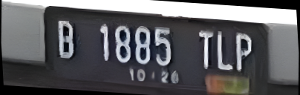

90
-179.84578812938565 



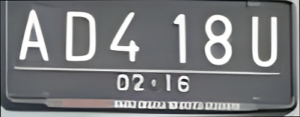

89
-179.28019203494918 



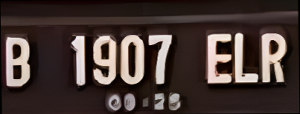

71
-0.05115693239982022 



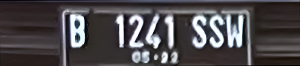

69
-155.3947589600265 



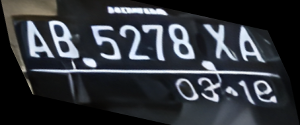

61
-1.3450938079597563 



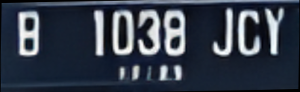

40
-177.17728565425125 



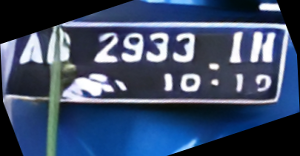

76


In [ ]:
# List gambar yang perlu dilakukan proses rotating tanpa cropping
buruk = [90, 89, 71, 69, 61, 40, 76]

# Lakukan iterasi di setiap gambar dalam list
for dian in buruk:
    # Membaca setiap gambar
    image = cv2.imread('/content/DataTest/ERESGAN_DataTest/DataTest'+str(dian)+'_out.png')

    # Melakukan proses contrast streching pada gambar
    image = contrast_stretching(image)

    # Melakukan resize gambar agar tidak terlalu besar atau kecil
    resized_image = resize_image(image)

    # Mendeteksi tepian gambar dengan canny
    edges = detect_edges(resized_image)

    # Mendeteksi tepian horizontal dari gambar
    lines = detect_lines(edges, threshold1=25, threshold2=10, min_line_length=15, max_line_gap=10)

    # Membuat copy dari gambar yang telah di resize
    rgb_image = resized_image.copy()

    # Mengkoleksi semua tepian horizontal dari gambar
    result = rgb_image.copy()
    green_slopes = []

    # Jika terdapat tepian yang terdeteksi, maka simpan dalam list
    if lines is not None:
        for line in lines:
            x1, y1, x2, y2 = line[0]
            if abs(y2 - y1) <= abs(x2 - x1):
                cv2.line(result, (x1, y1), (x2, y2), (0, 255, 0), 2)
                slope = (y2 - y1) / (x2 - x1)
                green_slopes.append(slope)

    # Mencari modus dari hasil clustering dari kemiringan horizontal
    slope_horizontal = average_middle_value(green_slopes)

    # Jika terdapat kemiringan yang horizontal, maka:
    if green_slopes:

        # Hitung sudut kemiringan horizontalnya
        angle = np.degrees(np.arctan(slope_horizontal))

        # Buat rotasi transformasi matriksnya
        center = (resized_image.shape[1] // 2, resized_image.shape[0] // 2)
        M = cv2.getRotationMatrix2D(center, angle, 1.0)

        # Lakukan rotasi gambar
        resized_image = cv2.warpAffine(resized_image, M, (resized_image.shape[1], resized_image.shape[0]))

    # Rotasi gambar ke 90derajat
    rotated_image = rotated_90(resized_image)

    # Convert gambar menuju Numpy Array
    rotated_image = np.array(rotated_image)

    # Mendeteksi tepian gambar dengan canny
    new_edges = detect_edges(rotated_image)
    new_lines = detect_lines(new_edges, threshold1=25, threshold2=15, min_line_length=15, max_line_gap=25)

    # Membuat copy dari gambar yang telah di rotasi
    rgb_image = rotated_image.copy()

    # Mengkoleksi semua tepian vertikal dari gambar
    result = rgb_image.copy()
    red_slopes = []

    # Jika terdapat tepian yang terdeteksi, maka simpan dalam list
    if lines is not None:
        for line in new_lines:
            x1, y1, x2, y2 = line[0]

            # Jika kemiringannya kurang dari 45derajat maka merupakan tepian vertikal
            if abs(y2 - y1) < abs(x2 - x1):
                cv2.line(result, (x1, y1), (x2, y2), (0, 0, 255), 2)
                slope = (y2 - y1) / (x2 - x1)
                red_slopes.append(slope)

    # Memvisualisasikan distribusi kemiringan vertikal
    slope_vertical = average_middle_value(red_slopes, bins = 20)

    # Membuat duplikat dari gambar yang telah dirotasi
    rgb_image = rotated_image.copy()

    # Menambahkan border hitam di dalam gambar
    image_with_border = add_black_border(rgb_image, border_size = rgb_image.shape[1])

    # Jika terdapat kemiringan vertikal yang kemiringannya 0, maka ubah ke 0.0001 agar tidak ada zero divisor
    if red_slopes:
        # Make sure zero divisor doesn't happen
        if slope_vertical == 0:
            slope_vertical = 0.0001

        # Menghitung kemiringan sesungguhnya
        real_slope = -1/slope_vertical

        # Mengubah kedalam derajat
        angle = math.degrees(math.atan(real_slope))
        real_angle = -(90 - angle)
        print(real_angle,'\n')

        # Mentransformasi gambar sesuai dengan kemiringannya
        transformed_image = transform_image(image_with_border, angle = real_angle)

        # Merotasi gambar menuju 270derajat
        for i in range(3):
            transformed_image = rotated_90(transformed_image)

    # Jika terdapat kemiringan vertikal, maka:
    if red_slopes:
        # Konversi gambar menjadi grayscale
        gray_transformed_image = cv2.cvtColor(transformed_image, cv2.COLOR_BGR2GRAY)

        # Hitung presentasi dari piksel abu dan piksel hitam
        total_pixels = gray_transformed_image.shape[0] * gray_transformed_image.shape[1]
        black_pixels = np.count_nonzero(gray_transformed_image == 0)
        percentage_black = (black_pixels / total_pixels) * 100

    # Jika ada kemiringan vertikal dan presentase piksel hitamnya sedikit, maka:
    if red_slopes and percentage_black < 90:

        # Lakukan pemotongan bagian hitam
        resized_image = crop_black(transformed_image)

        # Konversi gambar menuju Numpy array
        resized_image = np.array(resized_image)

    # Mengitung ukuran panjang dan tinggi gambar
    height, width = resized_image.shape[:2]

    # Mendefinisikan target lebar gambar yang diinginkan
    target_width = 300

    # Menghitung rasio perbesaran gambar
    ratio = target_width / float(width)

    # Menghitung tinggi gambar berdasarkan rasio perbesaran gambar
    target_height = int(height * ratio)

    # Resize gambarnya dengan menggunakan interpolasi berdasarkan tinggi yang diharapkan
    resized_image = cv2.resize(resized_image, (target_width, target_height), interpolation=cv2.INTER_CUBIC)

    # Mengkonversi gambar menjadi format PIL
    image = Image.fromarray(resized_image)

    # Menampilkan gambar hasil preprocessing
    cv2_imshow(resized_image)

    # Mengeprint iterasi
    print(dian)

    # Menyimpan gambar hasil preprocessing
    cv2.imwrite('/content/DataTest/DataTest_Rotasi/DataTest'+str(dian)+'_out.png', resized_image)

#**Validation Set**

In [ ]:
# Mendefinisikan path dari file zip data test dan path untuk menyimpan hasil ekstraknya
zip_file_path = '/content/drive/MyDrive/DataValidation/Data_Val.zip'
extract_path = '/content/drive/MyDrive/DataValidation/Validation_Set'

# Membaca file zip dari data test
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    # Mengekstract semua konten dari file zip ke extract path
    zip_ref.extractall(extract_path)

# Notifikasi bahwa file berhasil di ekstrak
print("File berhasil diekstrak")

File successfully extracted.


In [ ]:
# Nama folder untuk upload dan hasil
upload_folder = 'upload'
result_folder = 'results'

# Menghapus folder jika sudah ada
if os.path.isdir(upload_folder):
    shutil.rmtree(upload_folder)
if os.path.isdir(result_folder):
    shutil.rmtree(result_folder)

# Membuat folder baru untuk upload dan hasil
os.mkdir(upload_folder)
os.mkdir(result_folder)

# Path folder gambar
image_folder_path = '/content/drive/MyDrive/DataValidation/Validation_Set/Data Val'
png_files = [file for file in os.listdir(image_folder_path) if file.lower().endswith('.png')]

# Mengunggah gambar-gambar
for filename in png_files:
    file_path = os.path.join(image_folder_path, filename)
    dst_path = os.path.join(upload_folder, filename)
    shutil.copy(file_path, dst_path)
    print(f'Moved {filename} to {dst_path}')

# Menampilkan daftar file yang diunggah
uploaded_files = os.listdir(upload_folder)
print(f"Uploaded files: {uploaded_files}")

Moved DataVal61.png to upload/DataVal61.png
Moved DataVal60.png to upload/DataVal60.png
Moved DataVal91.png to upload/DataVal91.png
Moved DataVal58.png to upload/DataVal58.png
Moved DataVal75.png to upload/DataVal75.png
Moved DataVal97.png to upload/DataVal97.png
Moved DataVal80.png to upload/DataVal80.png
Moved DataVal76.png to upload/DataVal76.png
Moved DataVal94.png to upload/DataVal94.png
Moved DataVal100.png to upload/DataVal100.png
Moved DataVal67.png to upload/DataVal67.png
Moved DataVal70.png to upload/DataVal70.png
Moved DataVal59.png to upload/DataVal59.png
Moved DataVal68.png to upload/DataVal68.png
Moved DataVal77.png to upload/DataVal77.png
Moved DataVal92.png to upload/DataVal92.png
Moved DataVal71.png to upload/DataVal71.png
Moved DataVal73.png to upload/DataVal73.png
Moved DataVal87.png to upload/DataVal87.png
Moved DataVal96.png to upload/DataVal96.png
Moved DataVal63.png to upload/DataVal63.png
Moved DataVal72.png to upload/DataVal72.png
Moved DataVal81.png to upload/

In [ ]:
# Jika terjadi masalah kehabisan memori, coba gunakan opsi `--tile`
# Kami melakukan peningkatan ukuran pada gambar dengan faktor skala X3.5
!python inference_realesrgan.py -n RealESRGAN_x4plus -i upload --outscale 3.5 --face_enhance
# Argumen
# -n, --model_name: Nama model
# -i, --input: folder masukan atau gambar
# --outscale: Skala keluaran, dapat berupa faktor skala sembarang.

/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional_tensor.py:5: UserWarning: The torchvision.transforms.functional_tensor module is deprecated in 0.15 and will be **removed in 0.17**. Please don't rely on it. You probably just need to use APIs in torchvision.transforms.functional or in torchvision.transforms.v2.functional.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)
Testing 0 DataVal1
Testing 1 DataVal10
Testing 2 DataVal100
Testing 3 DataVal11
Testing 4 DataVal12
Testing 5 DataVal13
Testin

In [ ]:
# Mendownload Hasilnya
zip_filename = 'Real-ESRGAN_Val.zip'
if os.path.exists(zip_filename):
    os.remove(zip_filename)
os.system(f"zip -r -j {zip_filename} results/*")
files.download(zip_filename)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# Mendefinisikan path dari hasil proses ERSGAN dan path untuk menyimpan hasil ekstrak dari file zipnya
zip_file_path = '/content/drive/MyDrive/DataValidation/Validation_Set/Real-ESRGAN_Val.zip'
extract_path = '/content/drive/MyDrive/DataValidation/ERESGAN_DataVal'

# Membuka file zip
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    # Mengekstrak semua isi dari file zip ke dalam path ekstraksi yang telah ditentukan
    zip_ref.extractall(extract_path)

# Notifikasi untuk memastikan file berhasil diekstrak
print("File berhasil diekstrak.")

File successfully extracted.


-155.6114880243182 



/usr/local/lib/python3.10/dist-packages/transformers/models/yolos/feature_extraction_yolos.py:28: FutureWarning: The class YolosFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use YolosImageProcessor instead.
  warnings.warn(


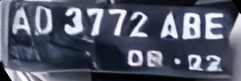

1
-4.868086147766817 



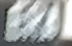

2
-19.71944158871672 



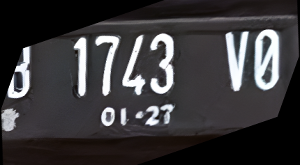

3
-179.92287111262925 



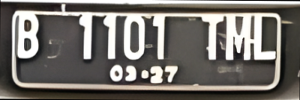

4
-179.8884472018632 



5
-166.11930710311358 



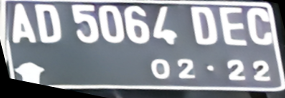

6
-4.328409476224095 



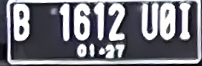

7
-0.04560866464426283 



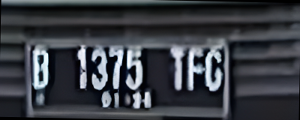

8
-10.701266470108166 



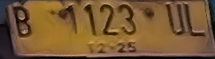

9
-179.3698553551792 



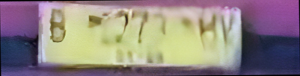

10
-4.136273908717911 



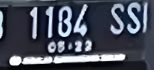

11
-8.61315217983055 



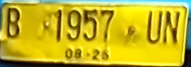

12


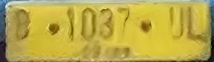

13
-0.41313702696083965 



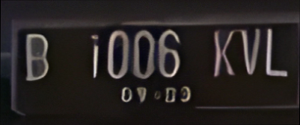

14
-173.143444743746 



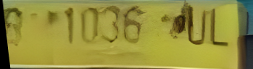

15
-179.584682238062 



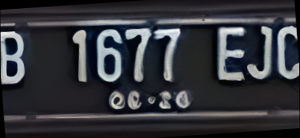

16
-179.2122326749457 



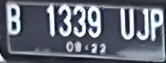

17
-0.1530096008543751 



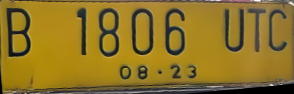

18
-13.455964335877084 



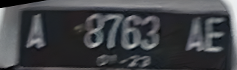

19
-179.84688233305363 



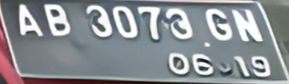

20


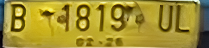

21
-179.26029914442535 



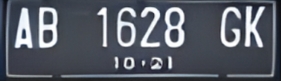

22
-5.126483164352592 



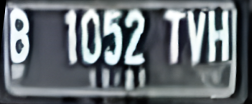

23
-3.4738495662434303 



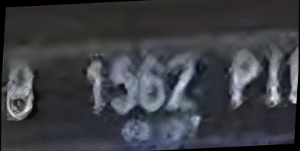

24
-0.16114395499015188 



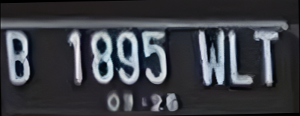

25
-178.5913479716727 



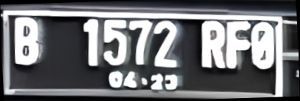

26


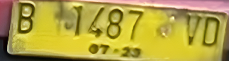

27
-0.8425242607404186 



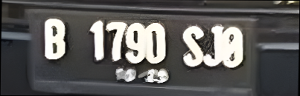

28
-8.327051211899686 



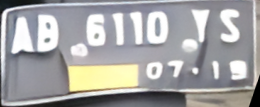

29
-0.046206263783901136 



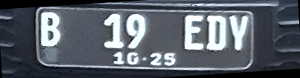

30
-177.29637441318852 



31
-169.86680148616585 



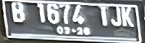

32
-0.8482708760809459 



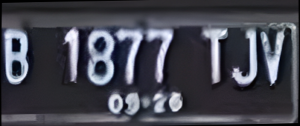

33
-179.25656767245468 



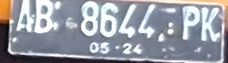

34
-179.91318827928967 



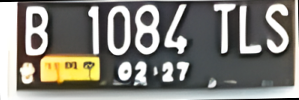

35
-179.9578707579505 



36
-5.69513040845348 



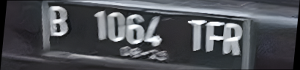

37
-179.61518338660937 



38
-5.140894019819939 



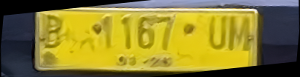

39
-4.700793903537786 



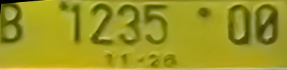

40


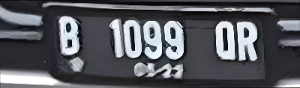

41
-10.164856728766637 



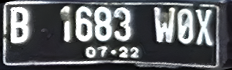

42
-24.34675185470492 



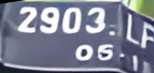

43
-5.083461845170447 



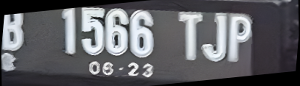

44
-9.376853347638928 



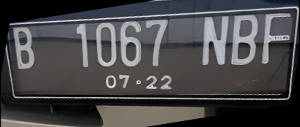

45
-179.83722833700688 



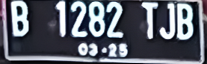

46
-0.20462691396585342 



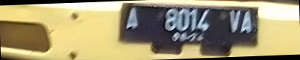

47
-0.32098140119357765 



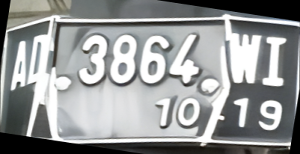

48
-4.711707315312438 



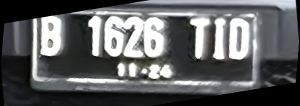

49
-6.0277890824711875 



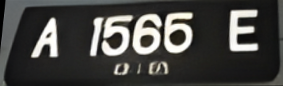

50
-2.2776089583340706 



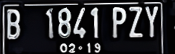

51
-178.05553770067633 



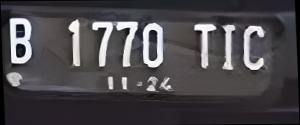

52
-3.0740425663391733 



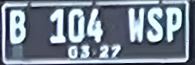

53
-179.95008323502302 



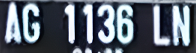

54
-178.5185428291129 



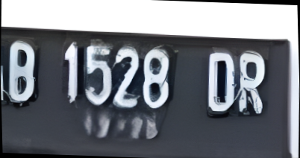

55
-2.960675493251429 



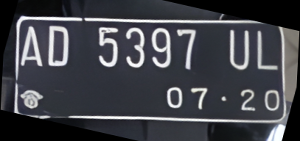

56
-179.47988936968596 



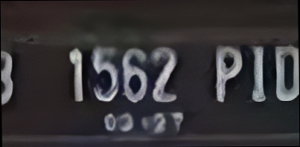

57
-5.126483164352592 



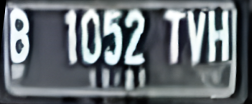

58
-15.33576237533319 



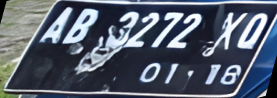

59


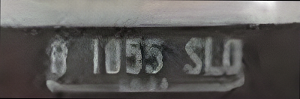

60
-173.143444743746 



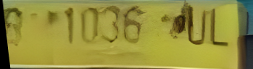

61
-179.3342046544859 



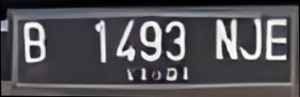

62
-178.21445219794947 



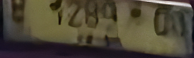

63
-166.11364704562317 



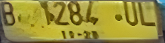

64
-175.3927138991985 



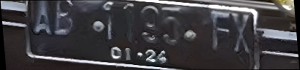

65
-173.50068033239972 



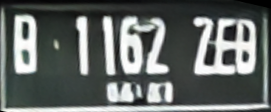

66
-3.2408515766596366 



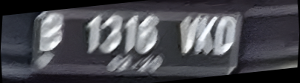

67
-179.74055741392593 



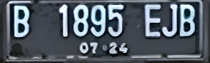

68
-1.2304510067307035 



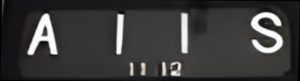

69
-0.16885902390637852 



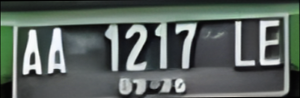

70
-0.18994726880978874 



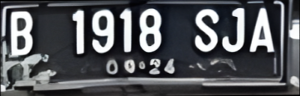

71
-10.045940836067203 



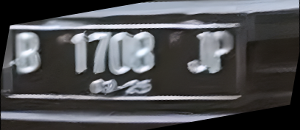

72
-3.1221610827293063 



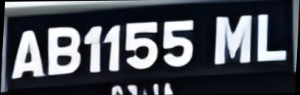

73
-6.509631932554228 



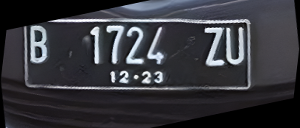

74
-171.586666251496 



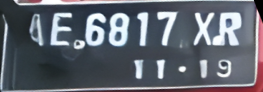

75
-9.739913002894951 



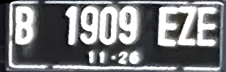

76
-15.465131447802591 



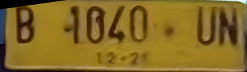

77
-0.09993439781115399 



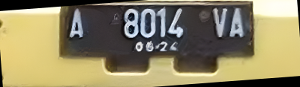

78
-4.934004516130187 



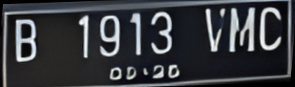

79
-179.94315896754318 



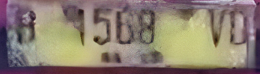

80
-2.7680413430555006 



81
-176.90594194108292 



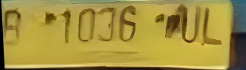

82
-1.1310774118412894 



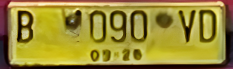

83
-178.85002592755498 



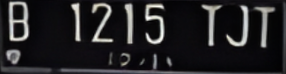

84
-179.99157415013235 



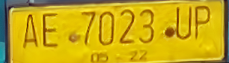

85


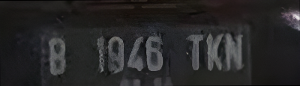

86
-2.157877690109018 



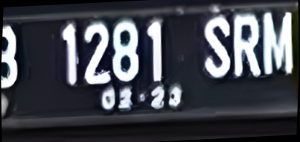

87
-178.97420545488393 



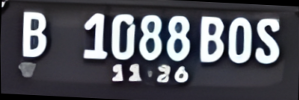

88
-5.811114014732951 



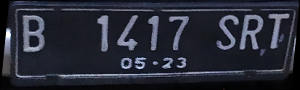

89
-14.287879715735556 



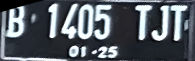

90
-6.588468760383492 



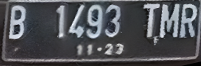

91
-176.83464244718044 



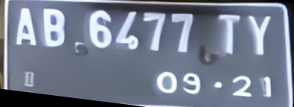

92
-179.3249947477389 



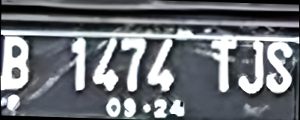

93
-179.9792406605051 



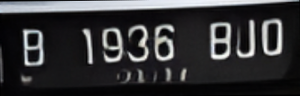

94
-2.3027113541307926 



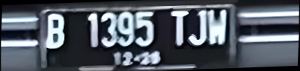

95
-26.957604097079304 



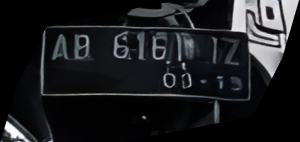

96
-0.26930256743422376 



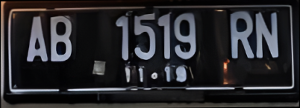

97


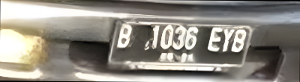

98
-1.1397871375392583 



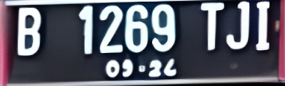

99
-16.69924423399361 



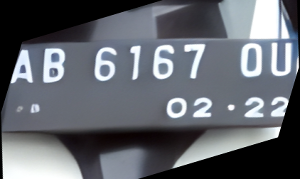

100


In [ ]:
# Melakukan iterasi untuk setiap file .png
for dian in range (1,101):
    # Membaca setiap gambar
    image = cv2.imread('/content/drive/MyDrive/DataValidation/ERESGAN_DataVal/DataVal'+str(dian)+'_out.png')

    # Melakukan proses contrast streching pada gambar
    image = contrast_stretching(image)

    # Melakukan resize gambar agar tidak terlalu besar atau kecil
    resized_image = resize_image(image)

    # Mendeteksi tepian gambar dengan canny
    edges = detect_edges(resized_image)

    # Mendeteksi tepian horizontal dari gambar
    lines = detect_lines(edges, threshold1=25, threshold2=10, min_line_length=15, max_line_gap=10)

    # Membuat copy dari gambar yang telah di resize
    rgb_image = resized_image.copy()

    # Mengkoleksi semua tepian horizontal dari gambar
    result = rgb_image.copy()

    # Jika terdapat tepian yang terdeteksi, maka simpan dalam list
    green_slopes = []
    if lines is not None:
        for line in lines:
            x1, y1, x2, y2 = line[0]

            # Jika kemiringannya Kurang dari 45derajat maka merupakan tepian horizontal
            if abs(y2 - y1) <= abs(x2 - x1):
                cv2.line(result, (x1, y1), (x2, y2), (0, 255, 0), 2)
                slope = (y2 - y1) / (x2 - x1)
                green_slopes.append(slope)

    # Mencari modus dari hasil clustering dari kemiringan horizontal
    slope_horizontal = average_middle_value(green_slopes)

    # Jika terdapat kemiringan yang horizontal, maka:
    if green_slopes:
        # Hitung sudut kemiringan horizontalnya
        angle = np.degrees(np.arctan(slope_horizontal))

        # Buat rotasi transformasi matriksnya
        center = (resized_image.shape[1] // 2, resized_image.shape[0] // 2)
        M = cv2.getRotationMatrix2D(center, angle, 1.0)

        # Lakukan rotasi gambar
        resized_image = cv2.warpAffine(resized_image, M, (resized_image.shape[1], resized_image.shape[0]))

    # Rotasi gambar ke 90derajat
    rotated_image = rotated_90(resized_image)

    # Convert gambar menuju Numpy Array
    rotated_image = np.array(rotated_image)

    # Mendeteksi tepian gambar dengan canny
    new_edges = detect_edges(rotated_image)
    new_lines = detect_lines(new_edges, threshold1=25, threshold2=15, min_line_length=15, max_line_gap=25)

    # Membuat copy dari gambar yang telah di rotasi
    rgb_image = rotated_image.copy()

    # Mengkoleksi semua tepian vertikal dari gambar
    result = rgb_image.copy()

    # Jika terdapat tepian yang terdeteksi, maka simpan dalam list
    red_slopes = []
    if lines is not None:
        for line in new_lines:
            x1, y1, x2, y2 = line[0]

            # Jika kemiringannya kurang dari 45derajat maka merupakan tepian vertikal
            if abs(y2 - y1) < abs(x2 - x1):
                cv2.line(result, (x1, y1), (x2, y2), (0, 0, 255), 2)
                slope = (y2 - y1) / (x2 - x1)
                red_slopes.append(slope)

    # Memvisualisasikan distribusi kemiringan vertikal
    slope_vertical = average_middle_value(red_slopes, bins = 20)

    # Membuat duplikat dari gambar yang telah dirotasi
    rgb_image = rotated_image.copy()

    # Menambahkan border hitam di dalam gambar
    image_with_border = add_black_border(rgb_image, border_size = rgb_image.shape[1])

    # Jika terdapat kemiringan vertikal yang kemiringannya 0, maka ubah ke 0.0001 agar tidak ada zero divisor
    if red_slopes:
        if slope_vertical == 0:
            slope_vertical = 0.0001

        # Menghitung kemiringan sesungguhnya
        real_slope = -1/slope_vertical

        # Mengubah kedalam derajat
        angle = math.degrees(math.atan(real_slope))
        real_angle = -(90 - angle)
        print(real_angle,'\n')

        # Mentransformasi gambar sesuai dengan kemiringannya
        transformed_image = transform_image(image_with_border, angle = real_angle)

        # Merotasi gambar menuju 270derajat
        for i in range(3):
            transformed_image = rotated_90(transformed_image)

    # Jika terdapat kemiringan vertikal, maka:
    if red_slopes:
        # Konversi gambar menjadi grayscale
        gray_transformed_image = cv2.cvtColor(transformed_image, cv2.COLOR_BGR2GRAY)

        # Hitung presentasi dari piksel abu dan piksel hitam
        total_pixels = gray_transformed_image.shape[0] * gray_transformed_image.shape[1]
        black_pixels = np.count_nonzero(gray_transformed_image == 0)
        percentage_black = (black_pixels / total_pixels) * 100

    # Jika ada kemiringan vertikal dan presentase piksel hitamnya sedikit, maka:
    if red_slopes and percentage_black < 90:
        # Lakukan pemotongan bagian hitam
        resized_image = crop_black(transformed_image)

        # Konversi gambar menuju Numpy array
        resized_image = np.array(resized_image)

    # Mengitung ukuran panjang dan tinggi gambar
    height, width = resized_image.shape[:2]

    # Mendefinisikan target lebar gambar yang diinginkan
    target_width = 300

    # Menghitung rasio perbesaran gambar
    ratio = target_width / float(width)

    # Menghitung tinggi gambar berdasarkan rasio perbesaran gambar
    target_height = int(height * ratio)

    # Resize gambarnya dengan menggunakan interpolasi berdasarkan tinggi yang diharapkan
    resized_image = cv2.resize(resized_image, (target_width, target_height), interpolation=cv2.INTER_CUBIC)

    # Mengkonversi gambar menjadi format PIL
    image = Image.fromarray(resized_image)

    # Memunculkan pre-trained YOLOS feature extractor dan model untuk deteksi plat nomor model
    feature_extractor = YolosFeatureExtractor.from_pretrained('nickmuchi/yolos-small-finetuned-license-plate-detection')
    model = YolosForObjectDetection.from_pretrained('nickmuchi/yolos-small-finetuned-license-plate-detection')

    # Menyiapkan input gambar untuk inferensi model
    inputs = feature_extractor(images=image, return_tensors="pt")

    # Hasil output dari pre trained modelnya
    outputs = model(**inputs)

    # Model memprediksi bounding boxnya
    logits = outputs.logits
    bboxes = outputs.pred_boxes

    # Mengkonversi output ke COCO API
    target_sizes = torch.tensor([image.size[::-1]])
    results = feature_extractor.post_process_object_detection(outputs, threshold=0.5, target_sizes=target_sizes)[0]

    # Membuat salinan dari gambar
    image_cv = np.array(image)
    image = image_cv.copy()

    # Melakukan iterasi dari keseluruhan bounding box
    for score, label, box in zip(results["scores"], results["labels"], results["boxes"]):
        box = [int(i) for i in box.tolist()]
        # Menggambar bounding boxnya ke dalam gambar
        cv2.rectangle(image_cv, (box[0], box[1]), (box[2], box[3]), (0, 255, 0), 2)
        # Menambahkan label dan skor kepercayaan dari model
        label_text = f'{model.config.id2label[label.item()]}: {round(score.item(), 3)}'

    # Melist skor kepercayaan
    confidence = results['scores'].tolist()

    # Jika ada bounding boxnya dan skor kepercayaannya lebih dari 90 maka:
    if len(confidence) > 0:
        if max(confidence) > 0.9:

            # Crop gambar berdasarkan bounding boxnya
            cropped_images = []
            for box in results["boxes"]:
                box = [int(i) for i in box.tolist()]
                cropped_image = image[box[1]:box[3], box[0]:box[2]]
                cropped_images.append(cropped_image)

            # Konversi gambar yang telah di crop ke dalam Numpy array
            resized_image = np.array(cropped_image)

    # Tampilkan gambar hasil preprocessing
    cv2_imshow(resized_image)

    # Print iterasi dan simpan gambar
    print(dian)
    cv2.imwrite('/content/drive/MyDrive/DataValidation/DataVal_Rotasi/DataVal'+str(dian)+'_out.png', resized_image)

###**Proses Rotating tanpa Cropping**

Melakukan proses yang sama namun tidak melakukan pemotongan gambar yang menghasilkan hasil pemotongan yang jelek

-4.868086147766817 



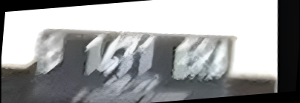

2
-179.8884472018632 



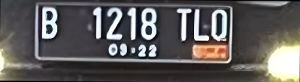

5
-177.29637441318852 



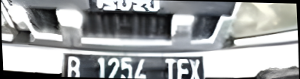

31
-179.9578707579505 



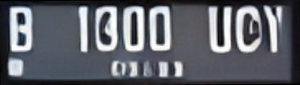

36
-179.61518338660937 



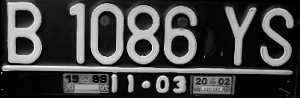

38
-2.7680413430555006 



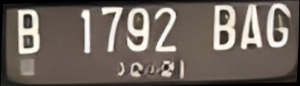

81


In [ ]:
# List gambar yang perlu dilakukan proses rotating tanpa cropping
buruk=[2, 5, 31, 36, 38, 81]

# Lakukan iterasi di setiap gambar dalam list
for dian in buruk:
    # Membaca setiap gambar
    image = cv2.imread('/content/drive/MyDrive/DataValidation/ERESGAN_DataVal/DataVal'+str(dian)+'_out.png')

    # Melakukan proses contrast streching pada gambar
    image = contrast_stretching(image)

    # Melakukan resize gambar agar tidak terlalu besar atau kecil
    resized_image = resize_image(image)

    # Mendeteksi tepian gambar dengan canny
    edges = detect_edges(resized_image)

    # Mendeteksi tepian horizontal dari gambar
    lines = detect_lines(edges, threshold1=25, threshold2=10, min_line_length=15, max_line_gap=10)

    # Membuat copy dari gambar yang telah di resize
    rgb_image = resized_image.copy()

    # Mengkoleksi semua tepian horizontal dari gambar
    result = rgb_image.copy()
    green_slopes = []

    # Jika terdapat tepian yang terdeteksi, maka simpan dalam list
    if lines is not None:
        for line in lines:
            x1, y1, x2, y2 = line[0]
            if abs(y2 - y1) <= abs(x2 - x1):
                cv2.line(result, (x1, y1), (x2, y2), (0, 255, 0), 2)
                slope = (y2 - y1) / (x2 - x1)
                green_slopes.append(slope)

    # Mencari modus dari hasil clustering dari kemiringan horizontal
    slope_horizontal = average_middle_value(green_slopes)

    # Jika terdapat kemiringan yang horizontal, maka:
    if green_slopes:

        # Hitung sudut kemiringan horizontalnya
        angle = np.degrees(np.arctan(slope_horizontal))

        # Buat rotasi transformasi matriksnya
        center = (resized_image.shape[1] // 2, resized_image.shape[0] // 2)
        M = cv2.getRotationMatrix2D(center, angle, 1.0)

        # Lakukan rotasi gambar
        resized_image = cv2.warpAffine(resized_image, M, (resized_image.shape[1], resized_image.shape[0]))

    # Rotasi gambar ke 90derajat
    rotated_image = rotated_90(resized_image)

    # Convert gambar menuju Numpy Array
    rotated_image = np.array(rotated_image)

    # Mendeteksi tepian gambar dengan canny
    new_edges = detect_edges(rotated_image)
    new_lines = detect_lines(new_edges, threshold1=25, threshold2=15, min_line_length=15, max_line_gap=25)

    # Membuat copy dari gambar yang telah di rotasi
    rgb_image = rotated_image.copy()

    # Mengkoleksi semua tepian vertikal dari gambar
    result = rgb_image.copy()
    red_slopes = []

    # Jika terdapat tepian yang terdeteksi, maka simpan dalam list
    if lines is not None:
        for line in new_lines:
            x1, y1, x2, y2 = line[0]

            # Jika kemiringannya kurang dari 45derajat maka merupakan tepian vertikal
            if abs(y2 - y1) < abs(x2 - x1):
                cv2.line(result, (x1, y1), (x2, y2), (0, 0, 255), 2)
                slope = (y2 - y1) / (x2 - x1)
                red_slopes.append(slope)

    # Memvisualisasikan distribusi kemiringan vertikal
    slope_vertical = average_middle_value(red_slopes, bins = 20)

    # Membuat duplikat dari gambar yang telah dirotasi
    rgb_image = rotated_image.copy()

    # Menambahkan border hitam di dalam gambar
    image_with_border = add_black_border(rgb_image, border_size = rgb_image.shape[1])

    # Jika terdapat kemiringan vertikal yang kemiringannya 0, maka ubah ke 0.0001 agar tidak ada zero divisor
    if red_slopes:
        if slope_vertical == 0:
            slope_vertical = 0.0001

        # Menghitung kemiringan sesungguhnya
        real_slope = -1/slope_vertical

        # Mengubah kedalam derajat
        angle = math.degrees(math.atan(real_slope))
        real_angle = -(90 - angle)
        print(real_angle,'\n')

        # Mentransformasi gambar sesuai dengan kemiringannya
        transformed_image = transform_image(image_with_border, angle = real_angle)

        # Merotasi gambar menuju 270derajat
        for i in range(3):
            transformed_image = rotated_90(transformed_image)

    # Jika terdapat kemiringan vertikal, maka:
    if red_slopes:
        # Konversi gambar menjadi grayscale
        gray_transformed_image = cv2.cvtColor(transformed_image, cv2.COLOR_BGR2GRAY)

        # Hitung presentasi dari piksel abu dan piksel hitam
        total_pixels = gray_transformed_image.shape[0] * gray_transformed_image.shape[1]
        black_pixels = np.count_nonzero(gray_transformed_image == 0)
        percentage_black = (black_pixels / total_pixels) * 100

    # Jika ada kemiringan vertikal dan presentase piksel hitamnya sedikit, maka:
    if red_slopes and percentage_black < 90:

        # Lakukan pemotongan bagian hitam
        resized_image = crop_black(transformed_image)

        # Konversi gambar menuju Numpy array
        resized_image = np.array(resized_image)

    # Mengitung ukuran panjang dan tinggi gambar
    height, width = resized_image.shape[:2]

    # Mendefinisikan target lebar gambar yang diinginkan
    target_width = 300

    # Menghitung rasio perbesaran gambar
    ratio = target_width / float(width)

    # Menghitung tinggi gambar berdasarkan rasio perbesaran gambar
    target_height = int(height * ratio)

    # Resize gambarnya dengan menggunakan interpolasi berdasarkan tinggi yang diharapkan
    resized_image = cv2.resize(resized_image, (target_width, target_height), interpolation=cv2.INTER_CUBIC)

    # Mengkonversi gambar menjadi format PIL
    image = Image.fromarray(resized_image)

    # Menampilkan gambar hasil preprocessing
    cv2_imshow(resized_image)

    # Mengeprint iterasi
    print(dian)

    # Menyimpan gambar hasil preprocessing
    cv2.imwrite('/content/drive/MyDrive/DataValidation/DataVal_Rotasi/DataVal'+str(dian)+'_out.png', resized_image)

#**Fine Tuning TrOCR**

### **Preparing the Path**

In [ ]:
data_dir = "/content/drive/MyDrive/DataTrain/Rotasi_Train"
image_files = [filename for filename in os.listdir(data_dir) if filename.endswith(".png")]
text_files = [filename.split("_")[0].replace("out.png", "") for filename in image_files]

In [ ]:
data_test = pd.read_csv('/content/drive/MyDrive/DataValidation/Validation_Set/Data Val/DataVal.csv')
data_val.head(5)
image_files = data_val['Name of File']
text_files = data_val['Vehicle registration plate']

In [ ]:
import pandas as pd
# Membuat DataFrame
df = pd.DataFrame({'file_name': image_files, 'text': text_files})
# Menghapus semua tanda spasi pada kolom 'text'
df['text'] = df['text'].str.replace(' ', '')
df['file_name'] = df['file_name'].str.replace('.png', '_out.png')
df.head(5)

<ipython-input-57-1358158204ce>:6: FutureWarning: The default value of regex will change from True to False in a future version.
  df['file_name'] = df['file_name'].str.replace('.png', '_out.png')


,file_name,text
0,DataVal1_out.png,AD3772ABE
1,DataVal2_out.png,B1471ERA
2,DataVal3_out.png,B1743VO
3,DataVal4_out.png,B1101TML
4,DataVal5_out.png,B1218TLQ


In [ ]:
from sklearn.model_selection import train_test_split

train_df, test_df = train_test_split(df, test_size=0.2)
# we reset the indices to start from zero
train_df.reset_index(drop=True, inplace=True)
test_df.reset_index(drop=True, inplace=True)

In [ ]:
import pandas as pd
# Membuat DataFrame
df = pd.DataFrame({'file_name': image_files, 'text': text_files})
df.head(5)

,file_name,text
0,B15MAH____out.png,B15MAH
1,AA1248MB__out.png,AA1248MB
2,B1280QO___out.png,B1280QO
3,B1470TLO__out.png,B1470TLO
4,AD1558BN__out.png,AD1558BN


###**Preprocessing**

In [ ]:
import torch
from torch.utils.data import Dataset
from PIL import Image

class PlatDataset(Dataset):
    def __init__(self, root_dir, df, processor, max_target_length=128):
        self.root_dir = root_dir
        self.df = df
        self.processor = processor
        self.max_target_length = max_target_length

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        # get file name + text
        file_name = self.df['file_name'][idx]
        text = self.df['text'][idx]
        # prepare image (i.e. resize + normalize)
        image = Image.open(self.root_dir + file_name).convert("RGB")
        pixel_values = self.processor(image, return_tensors="pt").pixel_values
        # add labels (input_ids) by encoding the text
        labels = self.processor.tokenizer(text,
                                          padding="max_length",
                                          max_length=self.max_target_length).input_ids
        # important: make sure that PAD tokens are ignored by the loss function
        labels = [label if label != self.processor.tokenizer.pad_token_id else -100 for label in labels]

        encoding = {"pixel_values": pixel_values.squeeze(), "labels": torch.tensor(labels)}
        return encoding


In [ ]:
train_dataset = PlatDataset(root_dir='/content/drive/MyDrive/DataValidation/DataVal_Rotasi/',
                           df=train_df,
                           processor=processor)
eval_dataset = PlatDataset(root_dir='/content/drive/MyDrive/DataValidation/DataVal_Rotasi/',
                           df=test_df,
                           processor=processor)

In [ ]:
# Set device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Load the TrOCR model and processor
model_name = 'microsoft/trocr-large-printed'
processor = TrOCRProcessor.from_pretrained(model_name)
model = VisionEncoderDecoderModel.from_pretrained(model_name)
model.to(device)

Could not find image processor class in the image processor config or the model config. Loading based on pattern matching with the model's feature extractor configuration.


Some weights of VisionEncoderDecoderModel were not initialized from the model checkpoint at microsoft/trocr-large-printed and are newly initialized: ['encoder.pooler.dense.bias', 'encoder.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


VisionEncoderDecoderModel(
  (encoder): ViTModel(
    (embeddings): ViTEmbeddings(
      (patch_embeddings): ViTPatchEmbeddings(
        (projection): Conv2d(3, 1024, kernel_size=(16, 16), stride=(16, 16))
      )
      (dropout): Dropout(p=0.0, inplace=False)
    )
    (encoder): ViTEncoder(
      (layer): ModuleList(
        (0-23): 24 x ViTLayer(
          (attention): ViTAttention(
            (attention): ViTSelfAttention(
              (query): Linear(in_features=1024, out_features=1024, bias=False)
              (key): Linear(in_features=1024, out_features=1024, bias=False)
              (value): Linear(in_features=1024, out_features=1024, bias=False)
              (dropout): Dropout(p=0.0, inplace=False)
            )
            (output): ViTSelfOutput(
              (dense): Linear(in_features=1024, out_features=1024, bias=True)
              (dropout): Dropout(p=0.0, inplace=False)
            )
          )
          (intermediate): ViTIntermediate(
            (dense): Line

In [ ]:
model_name_fine='/content/drive/MyDrive/model_trocr_fine_tuning'
#processor = TrOCRProcessor.from_pretrained(model_name_fine)
model = VisionEncoderDecoderModel.from_pretrained(model_name_fine)
model.to(device)

VisionEncoderDecoderModel(
  (encoder): ViTModel(
    (embeddings): ViTEmbeddings(
      (patch_embeddings): ViTPatchEmbeddings(
        (projection): Conv2d(3, 1024, kernel_size=(16, 16), stride=(16, 16))
      )
      (dropout): Dropout(p=0.0, inplace=False)
    )
    (encoder): ViTEncoder(
      (layer): ModuleList(
        (0-23): 24 x ViTLayer(
          (attention): ViTAttention(
            (attention): ViTSelfAttention(
              (query): Linear(in_features=1024, out_features=1024, bias=False)
              (key): Linear(in_features=1024, out_features=1024, bias=False)
              (value): Linear(in_features=1024, out_features=1024, bias=False)
              (dropout): Dropout(p=0.0, inplace=False)
            )
            (output): ViTSelfOutput(
              (dense): Linear(in_features=1024, out_features=1024, bias=True)
              (dropout): Dropout(p=0.0, inplace=False)
            )
          )
          (intermediate): ViTIntermediate(
            (dense): Line

In [ ]:
print("Number of training examples:", len(train_dataset))
print("Number of validation examples:", len(eval_dataset))

Number of training examples: 80
Number of validation examples: 20


In [ ]:
encoding = train_dataset[0]
for k,v in encoding.items():
  print(k, v.shape)

pixel_values torch.Size([3, 384, 384])
labels torch.Size([128])


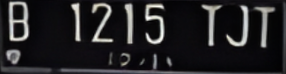

In [ ]:
image = Image.open(train_dataset.root_dir + train_df['file_name'][0]).convert("RGB")
image

In [ ]:
labels = encoding['labels']
labels[labels == -100] = processor.tokenizer.pad_token_id
label_str = processor.decode(labels, skip_special_tokens=True)
print(label_str)

B1215TJI


In [ ]:
from torch.utils.data import DataLoader

train_dataloader = DataLoader(train_dataset, batch_size=4, shuffle=True)
eval_dataloader = DataLoader(eval_dataset, batch_size=4)

###**Set Parameter Model**

In [ ]:
# set special tokens used for creating the decoder_input_ids from the labels
model.config.decoder_start_token_id = processor.tokenizer.cls_token_id
model.config.pad_token_id = processor.tokenizer.pad_token_id
# make sure vocab size is set correctly
model.config.vocab_size = model.config.decoder.vocab_size

# set beam search parameters
model.config.eos_token_id = processor.tokenizer.sep_token_id
model.config.max_length = 64
model.config.early_stopping = True
model.config.no_repeat_ngram_size = 3
model.config.length_penalty = 2.0
model.config.num_beams = 4

###**Fine tunning**

In [ ]:
cer_metric = load_metric("cer")
def compute_cer(pred_ids, label_ids):
    pred_str = processor.batch_decode(pred_ids, skip_special_tokens=True)
    label_ids[label_ids == -100] = processor.tokenizer.pad_token_id
    label_str = processor.batch_decode(label_ids, skip_special_tokens=True)

    cer = cer_metric.compute(predictions=pred_str, references=label_str)

    return cer

<ipython-input-70-55b908a0adb0>:1: FutureWarning: load_metric is deprecated and will be removed in the next major version of datasets. Use 'evaluate.load' instead, from the new library 🤗 Evaluate: https://huggingface.co/docs/evaluate
  cer_metric = load_metric("cer")


In [ ]:
optimizer = AdamW(model.parameters(), lr=5e-5)

for epoch in range(10):  # loop over the dataset multiple times
   # train
   model.train()
   train_loss = 0.0
   for batch in tqdm(train_dataloader):
      # get the inputs
      for k,v in batch.items():
        batch[k] = v.to(device)

      # forward + backward + optimize
      outputs = model(**batch)
      loss = outputs.loss
      loss.backward()
      optimizer.step()
      optimizer.zero_grad()

      train_loss += loss.item()

   print(f"Loss after epoch {epoch}:", train_loss/len(train_dataloader))

   # evaluate
   model.eval()
   valid_cer = 0.0
   with torch.no_grad():
     for batch in tqdm(eval_dataloader):
       # run batch generation
       outputs = model.generate(batch["pixel_values"].to(device))
       # compute metrics
       cer = compute_cer(pred_ids=outputs, label_ids=batch["labels"])
       valid_cer += cer

   print("Validation CER:", valid_cer / len(eval_dataloader))

model.save_pretrained(".")

/usr/local/lib/python3.10/dist-packages/transformers/optimization.py:411: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(


  0%|          | 0/20 [00:00<?, ?it/s]

Loss after epoch 0: 1.2069988936185836


  0%|          | 0/5 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/transformers/generation/utils.py:1369: UserWarning: Using `max_length`'s default (64) to control the generation length. This behaviour is deprecated and will be removed from the config in v5 of Transformers -- we recommend using `max_new_tokens` to control the maximum length of the generation.
  warnings.warn(


Validation CER: 0.30431451612903226


  0%|          | 0/20 [00:00<?, ?it/s]

Loss after epoch 1: 0.7012976765632629


  0%|          | 0/5 [00:00<?, ?it/s]

Validation CER: 0.11620967741935484


  0%|          | 0/20 [00:00<?, ?it/s]

Loss after epoch 2: 0.47973614037036894


  0%|          | 0/5 [00:00<?, ?it/s]

Validation CER: 0.1486962365591398


  0%|          | 0/20 [00:00<?, ?it/s]

Loss after epoch 3: 0.4124225787818432


  0%|          | 0/5 [00:00<?, ?it/s]

Validation CER: 0.1291263440860215


  0%|          | 0/20 [00:00<?, ?it/s]

Loss after epoch 4: 0.31737238764762876


  0%|          | 0/5 [00:00<?, ?it/s]

Validation CER: 0.20030913978494622


  0%|          | 0/20 [00:00<?, ?it/s]

Loss after epoch 5: 0.32204533368349075


  0%|          | 0/5 [00:00<?, ?it/s]

Validation CER: 0.12309139784946235


  0%|          | 0/20 [00:00<?, ?it/s]

Loss after epoch 6: 0.2756729066371918


  0%|          | 0/5 [00:00<?, ?it/s]

Validation CER: 0.18137096774193548


  0%|          | 0/20 [00:00<?, ?it/s]

Loss after epoch 7: 0.22670264467597007


  0%|          | 0/5 [00:00<?, ?it/s]

Validation CER: 0.20010752688172043


  0%|          | 0/20 [00:00<?, ?it/s]

Loss after epoch 8: 0.21752056628465652


  0%|          | 0/5 [00:00<?, ?it/s]

Validation CER: 0.15533602150537634


  0%|          | 0/20 [00:00<?, ?it/s]

Loss after epoch 9: 0.21688903570175172


  0%|          | 0/5 [00:00<?, ?it/s]

Validation CER: 0.15533602150537634


yang telah di fine tunning dengan data Validation

yang di fine tunning pake data training

In [ ]:
done=[]
undone=[]
for safrizal in range (1,101):
  image =  cv2.imread('/content/drive/MyDrive/DataValidation/DataVal_Rotasi/DataVal'+str(safrizal)+'_out.png')
  pixel_values = processor(images=image, return_tensors="pt").pixel_values.to(device)
  generated_ids = model.generate(pixel_values)
  generated_text = processor.batch_decode(generated_ids, skip_special_tokens=True)[0]
  # Menghilangkan spasi dari output
  generated_text = generated_text.replace(" ", "")
  generated_text = generated_text[:9]
  print(generated_text, "|",df['text'][safrizal-1])

print(done, len(done))
print(undone, len(undone))

AD3772AB | AD3772ABE
B1671EAOQ | B1471ERA
B1743VDO | B1743VO
B1101TMJ | B1101TML
B1218TLQ | B1218TLQ
AD5064DEC | AD5064DEC
B1612UO | B1612UOI
B1375TFG | B1375TFG
B11223UL | B1123UL
B1773WY | B1273HV
B1184SSL | B1184SSI
B1957UN | B1957UN
B1037UL | B1037UL
B10006KJL | B1006KVL
B1036UL | B1036UL
B1677EJC | B1677EJC
B1339UJP | B1339UJP
B1806UTC | B1806UTC
A8763UE | A8763AE
AB3073GN | AB3073GN
B1819UL | B1819UL
AB16268GJ | AB1628GK
B1052TVH | B1052TVH
B1562P11 | B1562PI
B1895WLT | B1895WLT
B1572RFOO | B1572RFO
B1487VD | B1487VD
B1790SJB | B1790SJO
AB6110TIS | AB6110YS
B19EDY | B19EDY
B1750TFX | B1254TFX
B1674TJK | B1674TJK
B1877TJV | B1877TJV
AB8644PK | AB8644PK
B1084TL | B1084TLS
B13003UCC | B1300UCY
B1064TFR | B1064TFR
B1086YRS | B1086YS
B1167UM | B1167UM
B1235QO | B1235QO
B1099QR | B1099QR
B1683WJ | B1683WOX
B1903LF | AB2903LF
B1566TJP | B1566TJP
B1067NJBF | B1067NBF
B1282TJB | B1282TJB
A1814VA | A8014VA
A6464WI | AD3864WI
B1626TID | B1626TID
A1566E15E | A1565E
B1841PZY | B1841PZY
B1770T

In [ ]:
done=[]
undone=[]
for safrizal in range (1,101):
  image =  cv2.imread('/content/drive/MyDrive/DataValidation/DataVal_Rotasi/DataVal'+str(safrizal)+'_out.png')
  pixel_values = processor(images=image, return_tensors="pt").pixel_values.to(device)
  generated_ids = model.generate(pixel_values)
  generated_text = processor.batch_decode(generated_ids, skip_special_tokens=True)[0]
  # Menghilangkan spasi dari output
  generated_text = generated_text.replace(" ", "")
  generated_text = generated_text[:9]
  print(generated_text,)

print(done, len(done))
print(undone, len(undone))

/usr/local/lib/python3.10/dist-packages/transformers/generation/utils.py:1369: UserWarning: Using `max_length`'s default (20) to control the generation length. This behaviour is deprecated and will be removed from the config in v5 of Transformers -- we recommend using `max_new_tokens` to control the maximum length of the generation.
  warnings.warn(


AD3772ABE
1
81743VO
81101TML
81218TLO
AD5064DEC
81612U81
81375TFG
B123UL
8-273-8V
1184SSI
B#1957*UN
B.1037.UL
B1006KVL
81036@UL
81677EJC
81339UJP
B1806UTC
A-8763AE
AB3073GN
B+4819%UL
AB1628GK
81052TVH
81562PM
B1895WLT
81572RF8
B1487&VD
81790SJU
ABST10YS
819EDY
SR195-TER
81674TJK
81877TJV
AB-864-PK
B1084TLS
B1300UCY
B1064TFR
B1086YS
8:1167-UM
81235:00
81099OR
B1683W8X
2903
81566TJP
81067NBF
B1282TJB
A8014VA
AM3864.WI
81626T10
A1565E
B1841PZY
B1770TIC
B104WSP
AG1136LN
81528DR
AD5397UL
1562PID
81052TVH
AB3272X6
@1055SLO
81036@UL
B1493NJE
81289-00
B.1284-UL
ABT.ITES-
8-1162ZEB
81216WO
B1895EJB
ALLS
AA1217LE
B1918SJA
8.70
AB1155ML
8:17:24ZU
AE.6817XR
81909EZE
B4040.UN
A8014VA
B1913VMC
81568VD
B1792BAG
8*1036MUL
BA-060-YD
B1215TJT
AE-7023-U
81946TKN
31281SRM
B1088BOS
B1417SRT
B1405TJT
B1493TMR
AB6/77TY
B1474TJS
B1936,BJO
B1395TJW
TOTALGIBR
AB1519RN
8:1036EY8
B1269TJL
AB6167-00
[] 0
[] 0


In [ ]:
done=[]
undone=[]
for safrizal in range (1,101):
  image =  cv2.imread('/content/drive/MyDrive/DataTest/ERESGAN_DataTest/DataTest'+str(safrizal)+'_out.png')
  pixel_values = processor(images=image, return_tensors="pt").pixel_values.to(device)
  generated_ids = model.generate(pixel_values)
  generated_text = processor.batch_decode(generated_ids, skip_special_tokens=True)[0]
  # Menghilangkan spasi dari output
  generated_text = generated_text.replace(" ", "")
  generated_text = generated_text[:9]
  print(generated_text,)

print(done, len(done))
print(undone, len(undone))

/usr/local/lib/python3.10/dist-packages/transformers/generation/utils.py:1369: UserWarning: Using `max_length`'s default (20) to control the generation length. This behaviour is deprecated and will be removed from the config in v5 of Transformers -- we recommend using `max_new_tokens` to control the maximum length of the generation.
  warnings.warn(


AD-7034SE
A9388EX
B16TB
B1661TKZ
TOTALSTRI
8-271-8V
81064TFR
81395TJW
61270RFD
81736BYH
B16ZYBIE
8:16:28:4
AD9313SS
8*1036.UL
81801TZS
B1474TJS
81939PU
B1260TZT
81376TJ8
BAR
LABSTRULL
81236PZN
BAB:8644P
B1JKT
AA7084.00
81131EKG
8-1037JN
8"1036JUL
10.90
A9192ZM
8.9120KXT
81643TRO
81390TJU
AB2681VEG
B1860EFT
A874.9FS
B1566FON
81063SJO
B1254TFX
81038JCY
AB4923.UH
B1509UNT
81937TUP
8.4.20Z-U
81026THZ
81724PYW
B1102SIV
AD.70340E
AB.4352.C
B1895EJB
B1786UJT
B1549,RFS
81869E&F
B1713-VX
B1063SPW
B1661TKZ
A8014VA
B-1873-YU
E
B1422BK
AB.5278X
AD4180
B1157Y
81233RFD
81031NI
AD99JR
B1683SEY
AA7004OF
B1241SSW
B1632T.U.
B1907ELR
81815TJ0
B1734UJN
81743EYF
81075.00
AMOUNT:18
B1523TJT
81157SSL
B1713-VX
TEL:
A(9380EX
B1532NKY
81800UYU
BTZILIVE
8:3787KE
B1329RFD
B1903RFD
AB2958CH
AD418U
B1885TLP
B1634SSN
AB.3511.0
8.1726.00
B1820TJV
B1619URB
88285
BAB:8644P
AG9718EG
B1509UNT
81408RX
[] 0
[] 0
